# Dependencies and files

## Install dependencies

## Imports

In [119]:
import warnings
import scanpy as sc
import anndata as an
import pandas as pd
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
import os

sc.settings.set_figure_params(dpi=80)
#sc.set_figure_params(facecolor="white", figsize=(8, 8))
warnings.simplefilter(action='ignore', category=FutureWarning)
sc.settings.verbosity = 3

# Global variables

In [120]:
de_dir_path = '../../../results/DE/mammals/ANOVA_zscore_laminar/'

In [121]:
os.makedirs('heatmaps', exist_ok=True)
os.makedirs('snakeplots', exist_ok=True)

In [122]:
os.listdir(de_dir_path)

['anova_zscore_mamm.csv',
 'cluster_spectr_anova_6.csv',
 'cluster_spectr_anova_7.csv',
 'cluster_spectr_anova_8.csv',
 'cluster_spectr_anova_9.csv',
 'desktop.ini',
 'ttest_zscore_human_monkeys.csv',
 'ttest_zscore_mamm.csv']

In [123]:
layers = ['L1', 'L2', 'L3', 'L4', 'L5', 'L6']
cluster_color = ['red', 'yellow', 'orange', 'green', 'purple', 'blue', 'olive', 'pink', 'brown']
clusters_labels = ['A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I']

### DE results

In [124]:
anova_res = pd.read_csv(de_dir_path + 'anova_zscore_mamm.csv', index_col=0)
anova_genes = anova_res[anova_res.p_val_adj < 0.05].index
anova_res.head()

,sum_sq,df,F,PR(>F),p_val_adj
NOC2L,5.221104,10.0,0.842126,0.590729,0.673788
KLHL17,7.392538,10.0,1.756889,0.089652,0.181595
HES4,10.147366,10.0,1.476590,0.171623,0.282792
AGRN,11.209840,10.0,2.786144,0.006975,0.029890
SDF4,12.915461,10.0,1.824119,0.076337,0.162215


In [125]:
ttest_res = pd.read_csv(de_dir_path + 'ttest_zscore_mamm.csv', index_col=0)
ttest_res.head()

,gene,layer,group1,group2,score,pvalue,p_val_adj
0,AGRN,L1,human,chimp,0.196414,0.850770,0.914458
1,UBE2J2,L1,human,chimp,-1.759429,0.128997,0.313726
2,ANKRD65,L1,human,chimp,-0.968948,0.369991,0.555576
3,TMEM240,L1,human,chimp,1.925872,0.102429,0.280322
4,NADK,L1,human,chimp,-7.397474,0.000313,0.011489


## Load normalized pseudobulks

In [126]:
pb_dir_path = '../../../data/pseudobulks/'

In [127]:
os.listdir(pb_dir_path)

['annotation_chimp.csv',
 'annotation_human.csv',
 'annotation_macaque.csv',
 'annotation_spatial_libd_human.csv',
 'expression_chimp.csv',
 'expression_human.csv',
 'expression_macaque.csv',
 'expression_mean_chimp.csv',
 'expression_mean_human.csv',
 'expression_mean_macaque.csv',
 'expression_mean_spatial_libd_human.csv',
 'expression_spatial_libd_human.csv',
 'expression_sum_chimp.csv',
 'expression_sum_human.csv',
 'expression_sum_macaque.csv',
 'expression_sum_spatial_libd_human.csv',
 'gene_sample_mean_chimp.csv',
 'gene_sample_mean_human.csv',
 'gene_sample_mean_macaque.csv',
 'gene_sample_mean_spatial_libd_human.csv',
 'pb_age.h5ad',
 'pb_age_sample_norm.h5ad',
 'pb_age_sample_norm_zscore.h5ad',
 'pb_mamm.h5ad',
 'pb_mamm_filtered.h5ad',
 'pb_mamm_laminar_filtered.h5ad',
 'pb_mamm_laminar_sample_zscore_filtered.h5ad',
 'pb_mamm_sample_norm.h5ad',
 'pb_mamm_sample_norm_filtered.h5ad',
 'pb_mamm_sample_norm_zscore.h5ad',
 'pb_mamm_sample_zscore_filtered.h5ad']

In [128]:
adata_pb_norm = sc.read_h5ad(pb_dir_path + 'pb_mamm_laminar_sample_zscore_filtered.h5ad')
adata_pb_norm.var = anova_res
adata_pb_norm

AnnData object with n_obs × n_vars = 76 × 9435
    obs: 'layer', 'sample_id', 'condition', 'lib_size', 'log_lib_size'
    var: 'sum_sq', 'df', 'F', 'PR(>F)', 'p_val_adj'
    uns: 'log1p', 'pca'
    obsm: 'X_pca'
    varm: 'PCs'

# PCA

In [129]:
adata_norm_anova = adata_pb_norm[:, adata_pb_norm.var.p_val_adj < 0.05]
df = pd.DataFrame(adata_norm_anova.X, columns=adata_norm_anova.var_names, index=adata_norm_anova.obs_names)
df.head()

,AGRN,UBE2J2,ANKRD65,TMEM240,NADK,GNB1,GABRD,PRXL2B,TP73,CHD5,...,PDE9A,NDUFV3,AGPAT3,PFKL,COL18A1,SLC19A1,COL6A2,LSS,DIP2A,PRMT2
L5.human_759,0.941529,1.184966,-1.243903,0.158311,0.356106,-0.133215,-1.135133,1.248247,0.970060,1.088127,...,1.129484,0.885143,-0.913210,1.064585,-0.592065,0.783214,0.225610,-0.140429,0.680244,-0.346517
L2.human_759,-1.298306,-0.947844,0.523121,-1.135065,0.038668,0.510181,-1.375785,0.258729,-0.633943,-0.269548,...,-1.536515,-1.181044,-0.106394,-0.157560,-0.004804,-1.791202,-0.822839,-1.111851,-0.975243,0.759532
L3.human_759,0.622130,0.207339,1.314273,-0.711472,-0.642581,0.762676,0.985921,0.491217,-0.633943,0.499558,...,0.915033,0.152762,-1.114841,0.034710,-0.483930,0.034719,-0.471914,-0.071219,-1.079287,-0.711799
L1.human_759,-0.868319,-1.273895,0.408551,-0.471025,-0.682409,-1.934125,0.397623,-1.167772,1.565711,-1.778558,...,0.365817,-1.313974,0.184877,-1.429609,1.996979,1.003277,1.920101,1.725510,0.999744,1.183187
L6.human_759,1.044826,-0.171655,-1.126632,0.519561,1.799359,0.602003,0.400810,0.428930,-0.633943,0.565250,...,-0.364426,0.657137,1.673808,1.159868,-0.396327,0.276502,-0.410020,0.382436,1.009366,0.559139


In [130]:
sample_order = dict()
for cond in ['human', 'chimp', 'macaque']:
    samples = df.loc[df.index.str.contains(cond)].index
    order = samples.sort_values()
    #order_laminar = order[order.str.contains('L')].tolist()
    #order_wm = order[order.str.contains('WM')].tolist()
    #sample_order[cond] = order_wm + order_laminar
    sample_order[cond] = order.tolist()
sample_order['all'] = sample_order['human'] + sample_order['chimp'] + sample_order['macaque']
df = df.loc[sample_order['all']]

In [131]:
import plotly.express as px
from sklearn.decomposition import PCA

pca = PCA(n_components=2)
components = pca.fit_transform(adata_pb_norm.X.T)

In [132]:
fig = px.scatter(components, x=0, y=1, hover_name=adata_pb_norm.var_names, color=(adata_pb_norm.var.p_val_adj < 0.05), opacity=0.5)
fig.show("notebook")

# Clustering ANOVA significant genes

## Hierarchal clustering

### Clustermap

D:\Projects\diploma\venv_stats2\lib\site-packages\seaborn\matrix.py:560: UserWarning:

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.



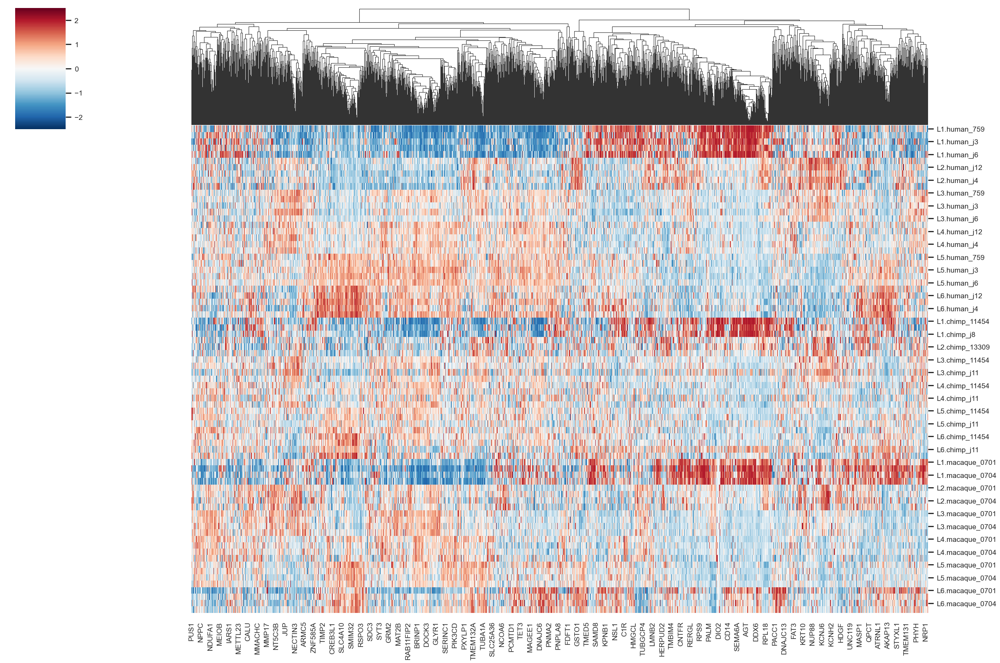

In [133]:
sns.set(font_scale=0.7)
sns.clustermap(df, figsize=(15, 10), cmap="RdBu_r", center=0, vmax=2.5, vmin=-2.5,
               metric='cosine', annot_kws={"size": 2},
               row_cluster=False).savefig('heatmaps/clustermap_anova.png')

## Spectral clustering (7 clusters)

In [134]:
n_clusters = 7
labels = pd.read_csv(de_dir_path + f'cluster_spectr_anova_{n_clusters}.csv', index_col=0)['0'].sort_values()
order = labels.sort_values().index

### Heatmap

Starting plotting..
Starting calculating row orders..
Reordering rows..
Starting calculating col orders..
Reordering cols..
Plotting matrix..
Starting plotting HeatmapAnnotations
Starting plotting HeatmapAnnotations
Plotting legends..


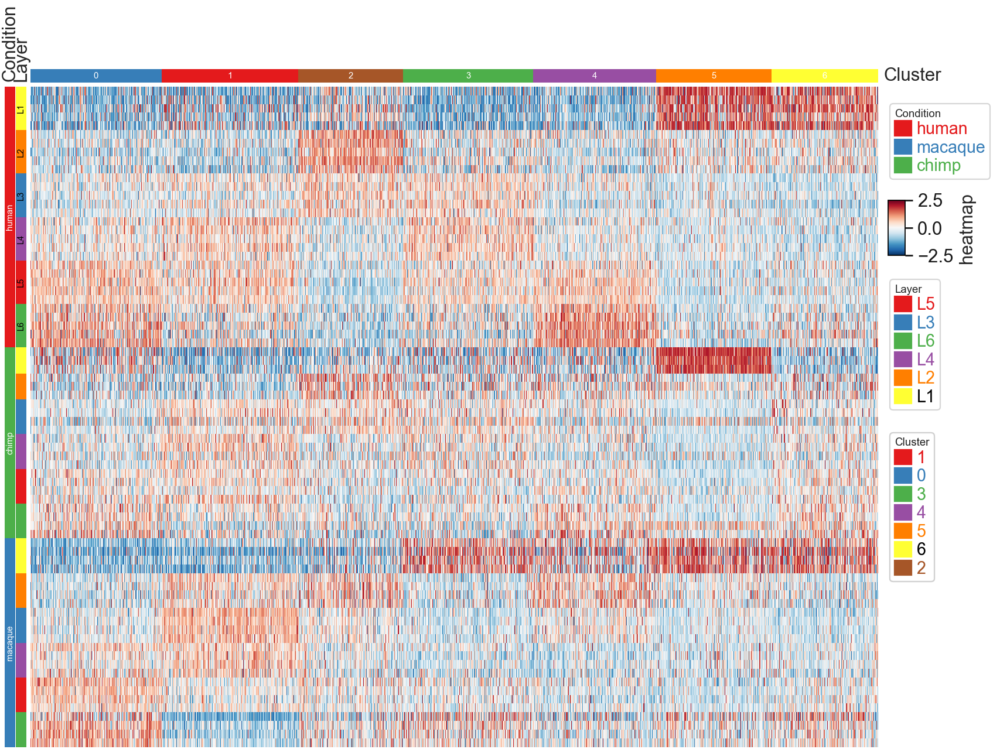

In [135]:
import PyComplexHeatmap as hm
from matplotlib.colors import LinearSegmentedColormap

col_ha = hm.HeatmapAnnotation(Cluster=hm.anno_simple(labels.sort_values().astype(str), legend=True, add_text=True), axis=1)

row_ha = hm.HeatmapAnnotation(Condition=hm.anno_simple(adata_norm_anova.obs.condition.astype(str), legend=True, add_text=True),
                              Layer=hm.anno_simple(adata_norm_anova.obs.layer.astype(str), legend=True, add_text=True), axis=0)

plt.figure(figsize=(12, 8))
sc.settings.set_figure_params(dpi=80)
cm = hm.ClusterMapPlotter(data=df.loc[sample_order['all'], order], top_annotation=col_ha, left_annotation=row_ha,
                       show_rownames=False, show_colnames=False, row_names_side='left',
                       cmap='RdBu_r', row_cluster=False, col_cluster=False,
                       rasterized=True, legend=True, legend_anchor='ax_heatmap', vmax=2.5, vmin=-2.5)
#legend_pad control the space between heatmap and legend.
plt.savefig(f'heatmaps/heatmap_spectr{n_clusters}_anova.png')
#plt.savefig("heatmaps/heatmap_spectr_hs_ann.pdf", bbox_inches='tight')
plt.show()

### Up heatmap

In [136]:
upreg_genes = (
    ttest_res
    .loc[(ttest_res.group1 == 'human') & (ttest_res.score > 0) & (ttest_res.p_val_adj < 0.05)]
    .gene
    .unique()
)

Starting plotting..
Starting calculating row orders..
Reordering rows..
Starting calculating col orders..
Reordering cols..
Plotting matrix..
Starting plotting HeatmapAnnotations
Starting plotting HeatmapAnnotations
Plotting legends..


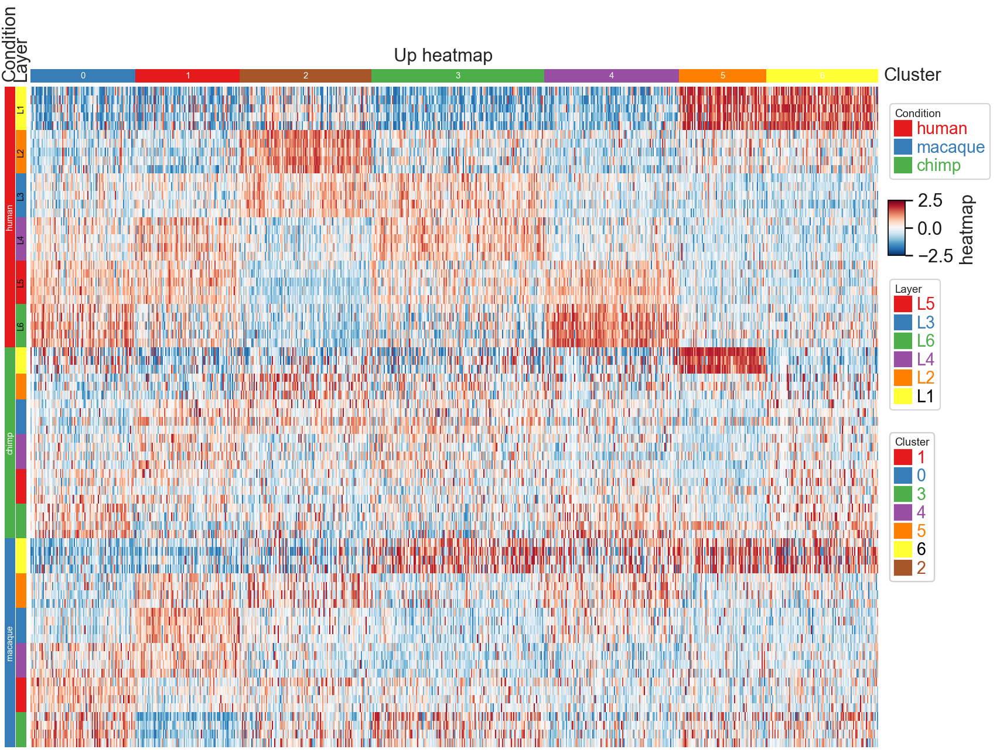

In [137]:
import PyComplexHeatmap as hm
from matplotlib.colors import LinearSegmentedColormap

col_ha = hm.HeatmapAnnotation(Cluster=hm.anno_simple(labels.sort_values().astype(str), legend=True, add_text=True), axis=1)

row_ha = hm.HeatmapAnnotation(Condition=hm.anno_simple(adata_norm_anova.obs.condition.astype(str), legend=True, add_text=True),
                              Layer=hm.anno_simple(adata_norm_anova.obs.layer.astype(str), legend=True, add_text=True), axis=0)

plt.figure(figsize=(12, 8))
plt.title('Up heatmap')
sc.settings.set_figure_params(dpi=80)
cm = hm.ClusterMapPlotter(data=df.loc[sample_order['all'], order.intersection(upreg_genes)], top_annotation=col_ha, left_annotation=row_ha,
                       show_rownames=False, show_colnames=False, row_names_side='left',
                       cmap='RdBu_r', row_cluster=False, col_cluster=False,
                       rasterized=True, legend=True, legend_anchor='ax_heatmap', vmax=2.5, vmin=-2.5)
#legend_pad control the space between heatmap and legend.
plt.savefig(f'heatmaps/heatmap_spectr{n_clusters}_anova_up.png')
#plt.savefig("heatmaps/heatmap_spectr_hs_ann.pdf", bbox_inches='tight')
plt.show()

<Axes: >

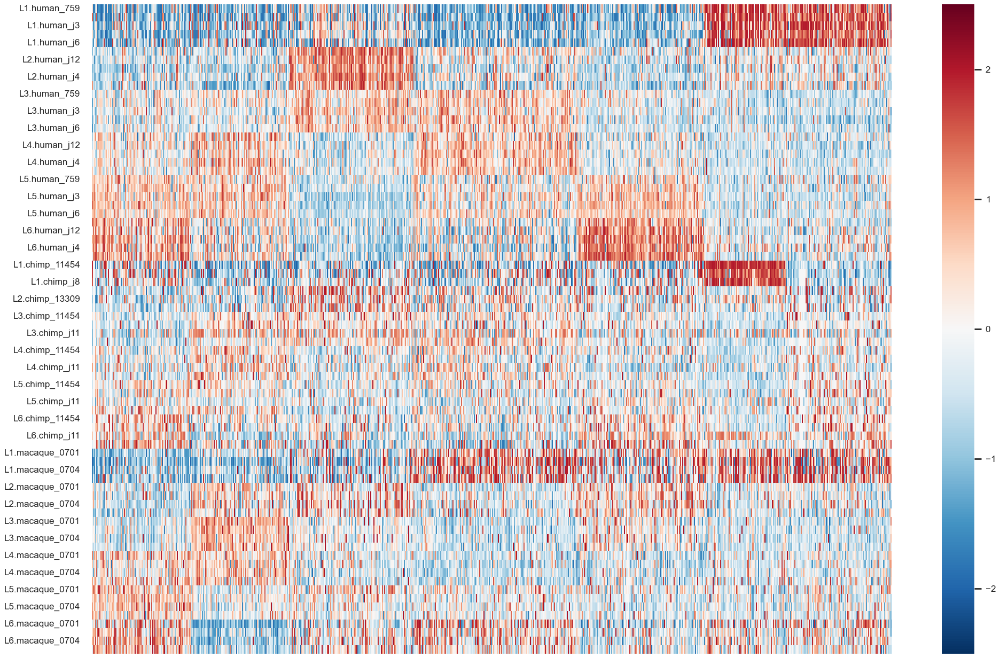

In [138]:
sc.settings.set_figure_params(dpi=80)
sns.set(font_scale=0.7)
fig, axes = plt.subplots(figsize=(15, 10))
sns.heatmap(df.loc[:, order.intersection(upreg_genes)], cmap="RdBu_r", vmax=2.5, vmin=-2.5, center=0, xticklabels=False)

### Heatmap for each layer

In [139]:
sc.settings.set_figure_params(dpi=80)
sns.set(font_scale=0.7)

meta NOT subset; don't know how to subset; dropped


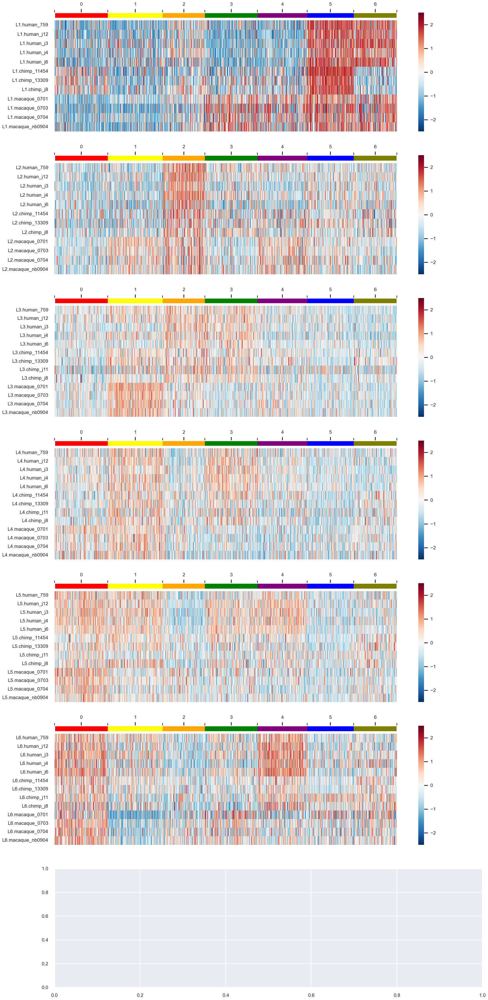

In [140]:
from matplotlib.patches import bbox_artist
from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib import ticker

clusters = np.arange(n_clusters)
colors = cluster_color[:n_clusters]
fig, axes = plt.subplots(n_clusters, 1, figsize=(12, 4 * n_clusters), gridspec_kw={'hspace': 0.2})

for ax, layer in zip(axes.flatten(), layers):
    df_layer = df.loc[df.index.str.contains(layer)]
    sns.heatmap(df_layer.loc[:, order], ax=ax, cmap="RdBu_r", vmax=2.5, vmin=-2.5, center=0, xticklabels=False)
    # colorbar
    divider = make_axes_locatable(ax)
    cax = divider.append_axes('top', size='5%', pad=0.05)
    cmap = mpl.colors.ListedColormap(colors)

    cluster_size = labels.value_counts().loc[clusters].values
    cluster_pos = cluster_size.cumsum()
    bounds = [0] + list(cluster_pos)
    norm = mpl.colors.BoundaryNorm(bounds, cmap.N)
    fig.colorbar(
        mpl.cm.ScalarMappable(cmap=cmap, norm=norm),
        cax=cax,
        ticks=bounds,
        orientation='horizontal',
        spacing='proportional'
    )
    cax.xaxis.set_major_locator(ticker.FixedLocator(cluster_pos - cluster_size / 2))
    cax.xaxis.set_major_formatter(ticker.FixedFormatter(clusters))
    cax.xaxis.tick_top() 
plt.savefig(f'heatmaps/heatmap_spectr{n_clusters}_anova_sep_clusters.png')
plt.savefig(f'heatmaps/heatmap_spectr{n_clusters}_anova_sep_clusters.pdf')

### Snakeplot for each layer

In [141]:
df_annotation = df.copy()
df_annotation['layer'] = adata_norm_anova.obs.layer
df_annotation['condition'] = adata_norm_anova.obs.condition

In [142]:
layer_mean = df_annotation.groupby(['condition', 'layer']).mean()
layer_mean.head()

AGRN    UBE2J2  ANKRD65   TMEM240      NADK      GNB1  \
condition layer                                                              
chimp     L1    -0.956192  0.773837      0.0 -1.754486  1.519086 -1.571840   
          L2    -1.097568 -0.993644      0.0 -0.077071 -1.233378  0.725357   
          L3    -0.228824 -0.175268      0.0 -0.006117  0.364381  0.733233   
          L4     0.716686  0.784959      0.0  0.508951  0.024738  0.677719   
          L5     0.673588 -0.446070      0.0  0.409698 -0.021703 -0.178134   

                    GABRD    PRXL2B      TP73      CHD5  ...     PDE9A  \
condition layer                                          ...             
chimp     L1    -0.549265 -0.357797  1.841219 -1.434529  ...  0.231898   
          L2    -0.855741  0.555384 -0.725681  0.374346  ...  0.852112   
          L3     0.887532  0.506415 -0.428375  0.481862  ... -0.612015   
          L4     0.382980  0.369754 -0.119940  0.284855  ... -0.468330   
          L5    -0.176356 -0.236206 -0.179036  0.095954  ...  0.158071   

                   NDUFV3    AGPAT3      PFKL   COL18A1   SLC19A1  COL6A2  \
condition layer                                                             
chimp     L1    -0.397632  1.532410  0.383942  2.013880 -0.756343     0.0   
          L2     0.388778 -0.320263  0.117511 -0.194445 -0.371989     0.0   
          L3    -0.637413 -0.114175 -0.112595 -0.209578  0.457760     0.0   
          L4    -0.407863 -0.933538 -0.211769 -0.650473 -0.339898     0.0   
          L5     0.136434 -0.188412 -0.209679 -0.040143 -0.386431     0.0   

                      LSS     DIP2A     PRMT2  
condition layer                                
chimp     L1    -0.136083 -0.648532 -0.666795  
          L2    -0.136083 -0.073788  0.984509  
          L3     0.885310 -0.930961 -0.949598  
          L4    -0.227062 -0.640886 -0.302950  
          L5    -0.227062  0.659761  0.064038  

[5 rows x 2740 columns]

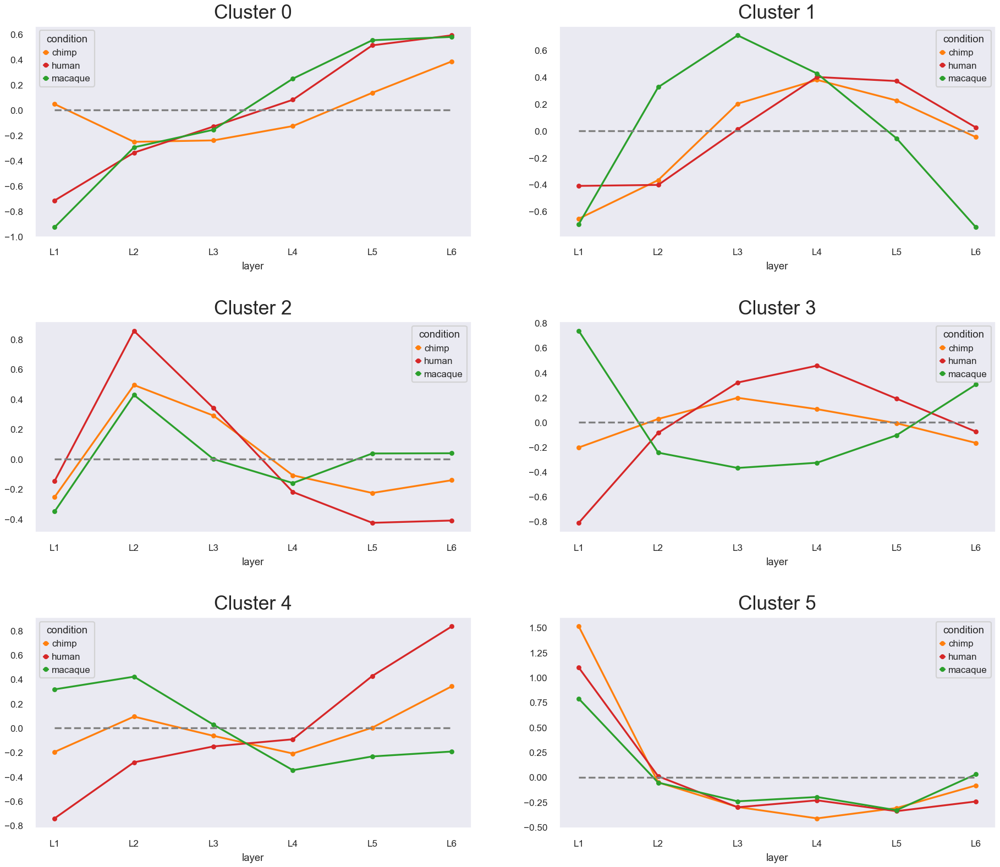

In [143]:
fig, axes = plt.subplots(n_clusters // 2, 2,  figsize=(14, 3.5 * n_clusters // 2), gridspec_kw={'hspace': 0.4})

for label, ax in zip(clusters, axes.flatten()):
    genes = labels[labels == label].index.tolist()

    (
        layer_mean[genes]
        .mean(axis=1)
        .reorder_levels(['layer', 'condition'])
        .unstack().loc[layers]
        .plot
        .line(color={'human': 'tab:red', 'chimp': 'tab:orange', 'macaque': 'tab:green'}, ax=ax, marker='.')
    )
    ax.set_title(f'Cluster {label}', fontsize=16)
    ax.grid(False)
    ax.hlines(0, xmin=0, xmax=5, colors='gray', linestyles='dashed')
    #plt.savefig(f'snakeplots/snakeplot_layers_mean_only_clusters{n_clusters}.png', bbox_inches='tight')
    #plt.savefig(f'snakeplots/snakeplot_layers_mean_only_clusters{n_clusters}.pdf', bbox_inches='tight')

### Z-scored Heatmap

In [144]:
df_zscored = (df - df.mean()) / df.std()

Starting plotting..
Starting calculating row orders..
Reordering rows..
Starting calculating col orders..
Reordering cols..
Plotting matrix..
Starting plotting HeatmapAnnotations
Starting plotting HeatmapAnnotations
Plotting legends..


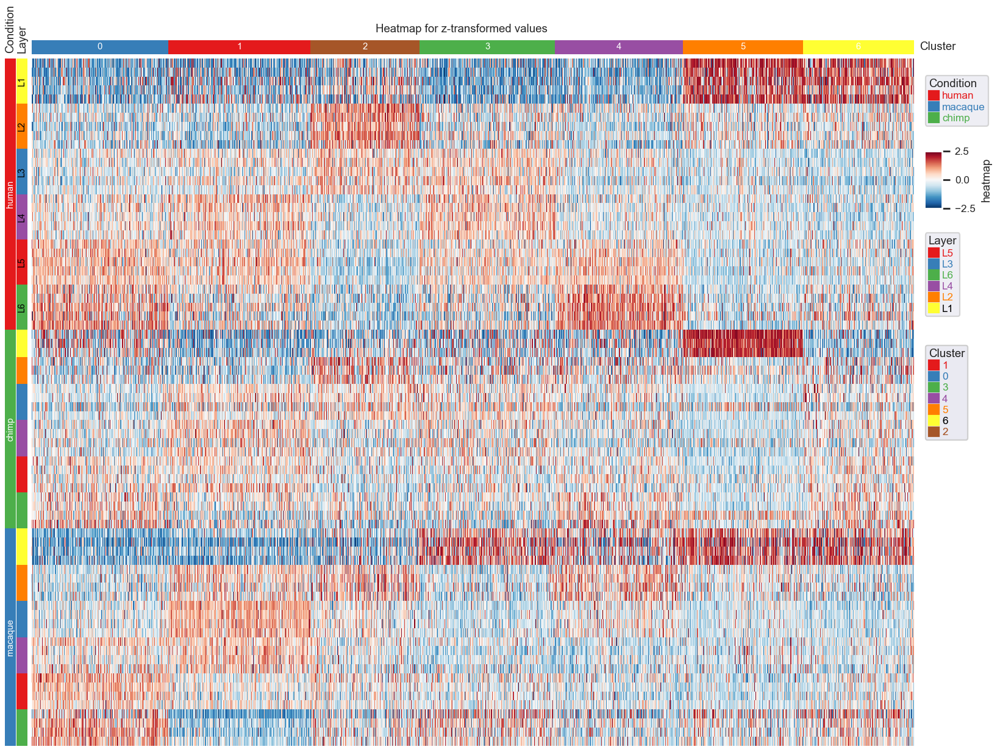

In [145]:
import PyComplexHeatmap as hm
from matplotlib.colors import LinearSegmentedColormap

col_ha = hm.HeatmapAnnotation(Cluster=hm.anno_simple(labels.sort_values().astype(str), legend=True, add_text=True), axis=1)

row_ha = hm.HeatmapAnnotation(Condition=hm.anno_simple(adata_norm_anova.obs.condition.astype(str), legend=True, add_text=True),
                              Layer=hm.anno_simple(adata_norm_anova.obs.layer.astype(str), legend=True, add_text=True), axis=0)

plt.figure(figsize=(12, 8))
plt.title('Heatmap for z-transformed values')
cm = hm.ClusterMapPlotter(data=df_zscored.loc[sample_order['all'], order], top_annotation=col_ha, left_annotation=row_ha,
                       show_rownames=False, show_colnames=False, row_names_side='left',
                       cmap='RdBu_r', row_cluster=False, col_cluster=False,
                       rasterized=True, legend=True, legend_anchor='ax_heatmap', vmax=2.5, vmin=-2.5)
#legend_pad control the space between heatmap and legend.
plt.savefig(f'heatmaps/heatmap_spectr_zscored{n_clusters}_anova.png')
#plt.savefig("heatmaps/heatmap_spectr_hs_ann.pdf", bbox_inches='tight')
plt.show()

### Heatmaps for human-specific genes

In [146]:
genes_hs = ttest_res[(ttest_res.group1 == 'human') & (ttest_res.p_val_adj < 0.05)].gene.unique()
df_hs = df[genes_hs].copy()

Starting plotting..
Starting calculating row orders..
Reordering rows..
Starting calculating col orders..
Reordering cols..
Plotting matrix..
Starting plotting HeatmapAnnotations
Starting plotting HeatmapAnnotations
Plotting legends..


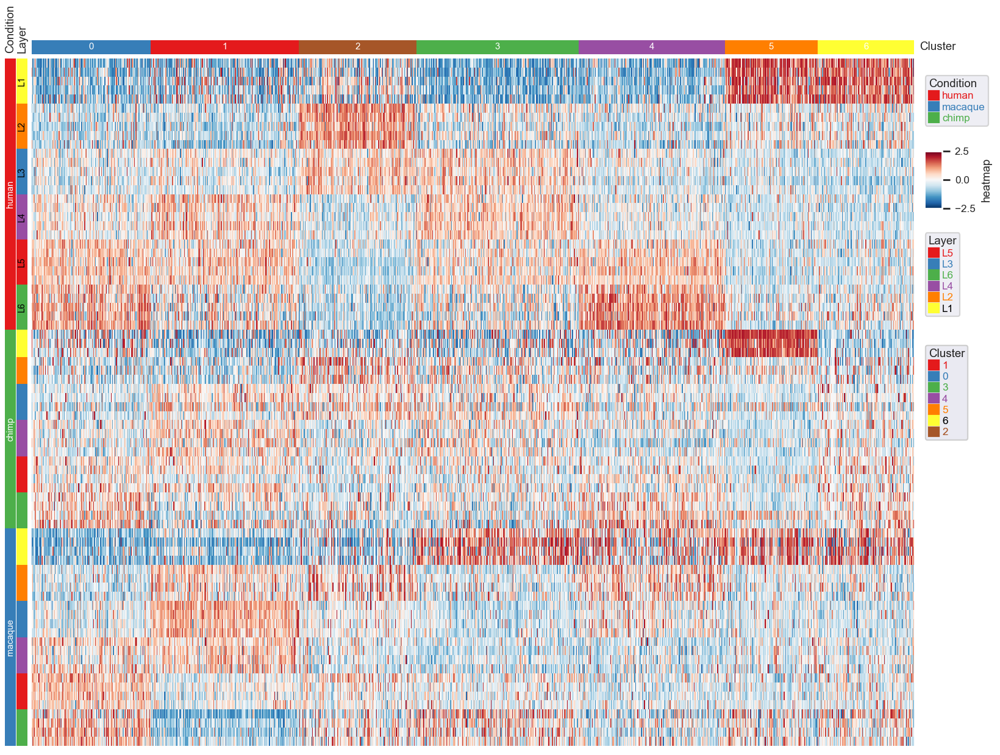

In [147]:
import PyComplexHeatmap as hm
from matplotlib.colors import LinearSegmentedColormap

col_ha = hm.HeatmapAnnotation(Cluster=hm.anno_simple(labels.sort_values().astype(str), legend=True, add_text=True), axis=1)

row_ha = hm.HeatmapAnnotation(Condition=hm.anno_simple(adata_norm_anova.obs.condition.astype(str), legend=True, add_text=True),
                              Layer=hm.anno_simple(adata_norm_anova.obs.layer.astype(str), legend=True, add_text=True), axis=0)

plt.figure(figsize=(12, 8))
order_hs = order.intersection(df_hs.columns)
cm = hm.ClusterMapPlotter(data=df_hs.loc[sample_order['all'], order_hs], top_annotation=col_ha, left_annotation=row_ha,
                       show_rownames=False, show_colnames=False, row_names_side='left',
                       cmap='RdBu_r', row_cluster=False, col_cluster=False,
                       rasterized=True, legend=True, legend_anchor='ax_heatmap', vmax=2.5, vmin=-2.5)
#legend_pad control the space between heatmap and legend.
plt.savefig(f'heatmaps/heatmap_spectr{n_clusters}_anova_hs.png')
#plt.savefig("heatmaps/heatmap_spectr_hs_ann.pdf", bbox_inches='tight')
plt.show()

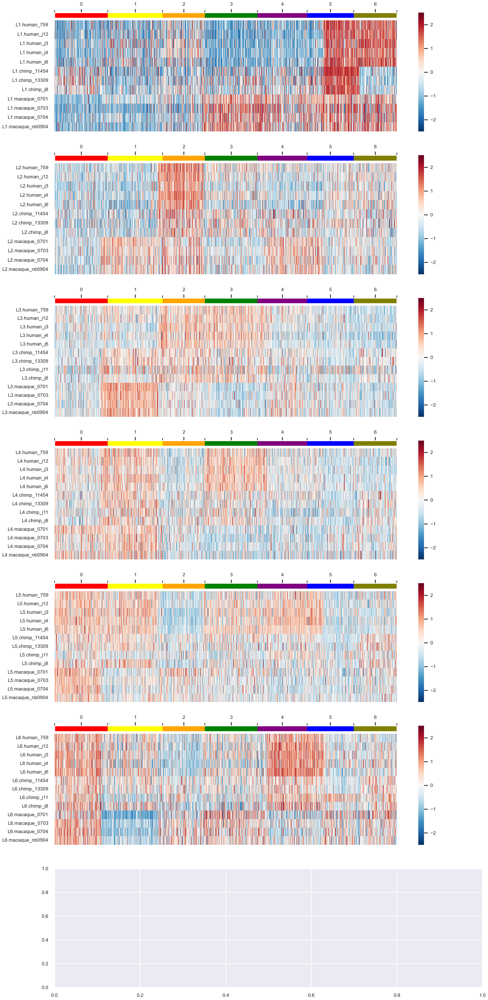

In [148]:
from matplotlib.patches import bbox_artist
from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib import ticker

clusters = np.arange(n_clusters)
colors = cluster_color[:n_clusters]
fig, axes = plt.subplots(n_clusters, 1, figsize=(12, 4 * n_clusters), gridspec_kw={'hspace': 0.2})

for ax, layer in zip(axes.flatten(), layers):
    df_layer = df_hs.loc[df.index.str.contains(layer)]
    sns.heatmap(df_layer.loc[:, order_hs], ax=ax, cmap="RdBu_r", vmax=2.5, vmin=-2.5, center=0, xticklabels=False)
    # colorbar
    divider = make_axes_locatable(ax)
    cax = divider.append_axes('top', size='5%', pad=0.05)
    cmap = mpl.colors.ListedColormap(colors)

    cluster_size = labels.value_counts().loc[clusters].values
    cluster_pos = cluster_size.cumsum()
    bounds = [0] + list(cluster_pos)
    norm = mpl.colors.BoundaryNorm(bounds, cmap.N)
    fig.colorbar(
        mpl.cm.ScalarMappable(cmap=cmap, norm=norm),
        cax=cax,
        ticks=bounds,
        orientation='horizontal',
        spacing='proportional'
    )
    cax.xaxis.set_major_locator(ticker.FixedLocator(cluster_pos - cluster_size / 2))
    cax.xaxis.set_major_formatter(ticker.FixedFormatter(clusters))
    cax.xaxis.tick_top() 
plt.savefig(f'heatmaps/heatmap_spectr{n_clusters}_anova_hs_layers.png', bbox_inches='tight')
#plt.savefig(f'heatmaps/heatmap_spectr{n_clusters}_anova_hs_layers.pdf', bbox_inches='tight')

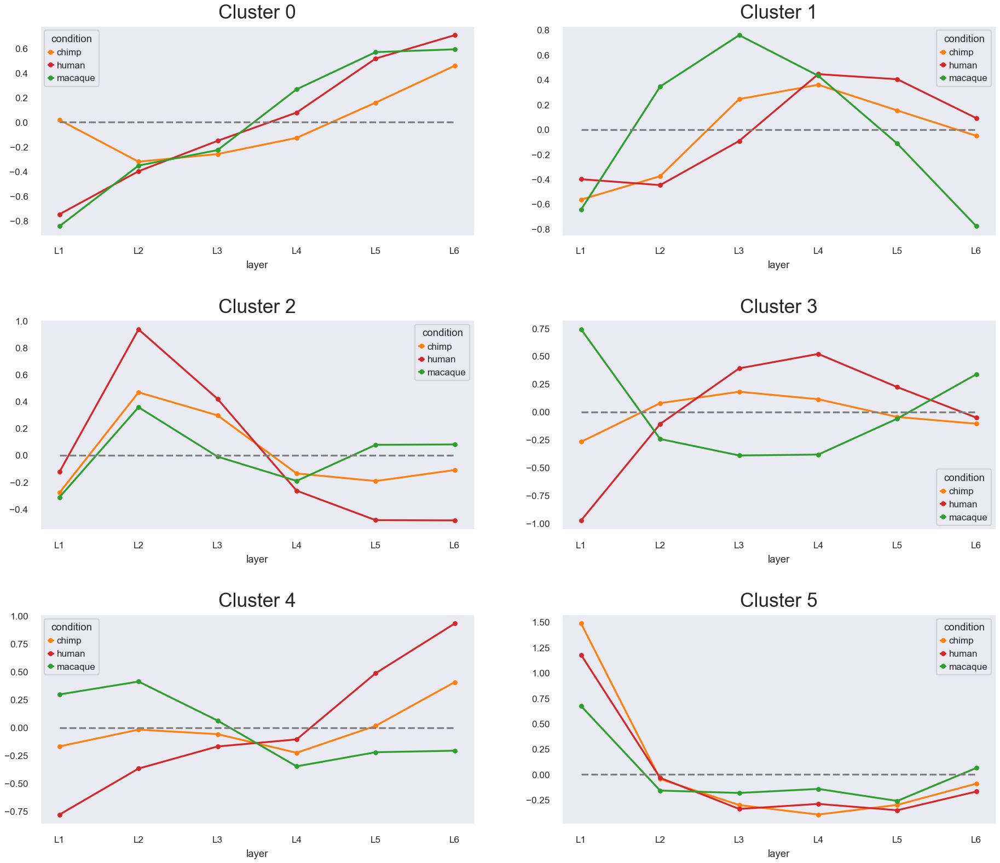

In [149]:
fig, axes = plt.subplots(n_clusters // 2, 2,  figsize=(14, 3.5 * n_clusters // 2), gridspec_kw={'hspace': 0.4})

for label, ax in zip(clusters, axes.flatten()):
    genes = labels.loc[order_hs][labels == label].index.tolist()

    (
        layer_mean[genes]
        .mean(axis=1)
        .reorder_levels(['layer', 'condition'])
        .unstack().loc[layers]
        .plot
        .line(color={'human': 'tab:red', 'chimp': 'tab:orange', 'macaque': 'tab:green'}, ax=ax, marker='.')
    )
    ax.set_title(f'Cluster {label}', fontsize=16)
    ax.grid(False)
    ax.hlines(0, xmin=0, xmax=5, colors='gray', linestyles='dashed')
    #plt.savefig(f'snakeplots/snakeplot_layers_mean_only_clusters{n_clusters}.png', bbox_inches='tight')
    #plt.savefig(f'snakeplots/snakeplot_layers_mean_only_clusters{n_clusters}.pdf', bbox_inches='tight')

Starting plotting..
Starting calculating row orders..
Reordering rows..
Starting calculating col orders..
Reordering cols..
Plotting matrix..
Starting plotting HeatmapAnnotations
Starting plotting HeatmapAnnotations
Plotting legends..


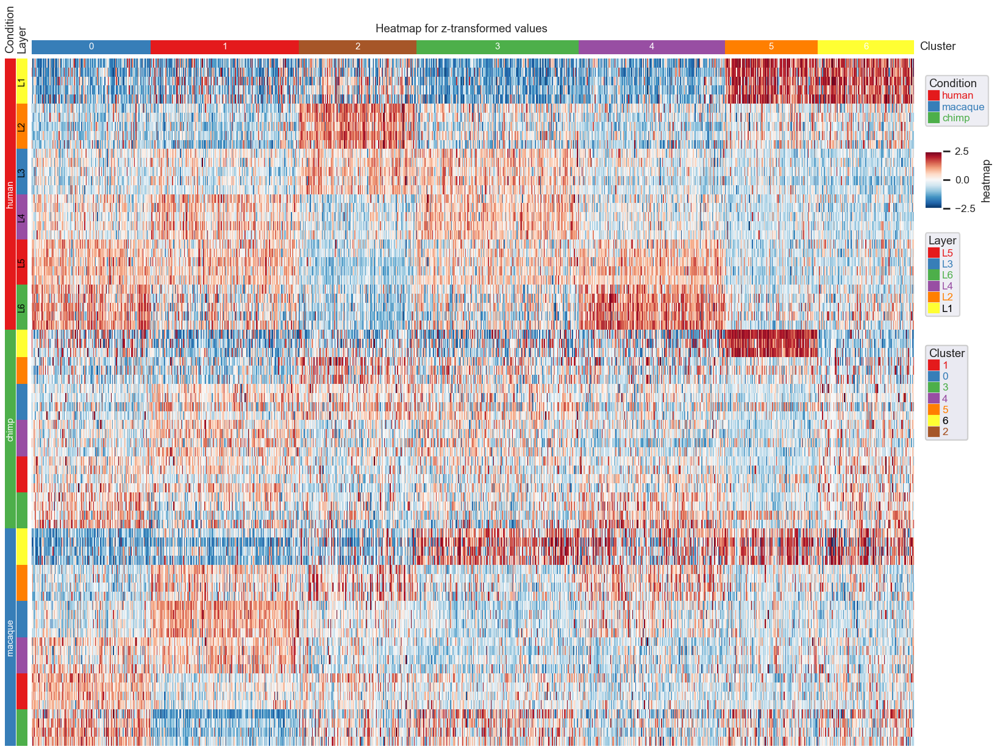

In [150]:
col_ha = hm.HeatmapAnnotation(Cluster=hm.anno_simple(labels.sort_values().astype(str), legend=True, add_text=True), axis=1)

row_ha = hm.HeatmapAnnotation(Condition=hm.anno_simple(adata_norm_anova.obs.condition.astype(str), legend=True, add_text=True),
                              Layer=hm.anno_simple(adata_norm_anova.obs.layer.astype(str), legend=True, add_text=True), axis=0)

plt.figure(figsize=(12, 8))
plt.title('Heatmap for z-transformed values')

cm = hm.ClusterMapPlotter(data=df_zscored.loc[sample_order['all'], order_hs], top_annotation=col_ha, left_annotation=row_ha,
                       show_rownames=False, show_colnames=False, row_names_side='left',
                       cmap='RdBu_r', row_cluster=False, col_cluster=False,
                       rasterized=True, legend=True, legend_anchor='ax_heatmap', vmax=2.5, vmin=-2.5)
#legend_pad control the space between heatmap and legend.
plt.savefig(f'heatmaps/heatmap_spectr_zscored_hs_{n_clusters}_anova.png')
#plt.savefig("heatmaps/heatmap_spectr_hs_ann.pdf", bbox_inches='tight')
plt.show()

### Snakeplot

In [151]:
df_hs.head()

,NADK,PPCS,ALG6,TTLL7,S1PR1,KCND3,ANKRD34A,RGS5,ACBD6,PROX1,...,SEPTIN9,TSHZ1,TSHZ3,MYADM,RTN4R,PARVB,FBLN1,MAPK8IP2,SOD1,PCP4
L1.human_759,-0.682409,-1.816304,0.926849,-1.653004,1.967958,1.042262,-1.791069,0.530706,1.194141,0.900331,...,1.948328,-0.064522,-0.602224,-1.229268,-1.818776,-0.996267,1.977491,-1.723333,-1.617236,-0.787797
L1.human_j12,-1.123540,-1.419136,1.639514,-1.571824,1.982125,1.953635,-1.734015,1.282650,1.449830,1.372243,...,1.634929,0.420698,-0.969757,-1.554227,-1.839721,-0.597929,1.793219,-1.150208,-0.001120,-0.741912
L1.human_j3,-1.011629,-1.173988,1.814323,-1.019845,1.939649,1.815071,-1.738287,1.979396,1.409994,1.891866,...,0.839585,1.288094,-1.392429,-1.370334,0.024371,-0.490684,-1.113457,-1.251036,-0.019352,0.173833
L1.human_j4,-0.923861,-1.863312,1.479952,-0.598872,1.957123,1.726734,-1.755117,1.473382,0.943100,1.417145,...,1.739608,0.010511,-0.927164,-1.683602,-1.773536,-0.096448,0.281923,-1.683199,-1.433313,-0.540773
L1.human_j6,0.136143,-1.849086,0.713082,-0.824975,1.574814,1.479759,-1.872145,2.035663,1.890631,1.654207,...,1.848190,1.153233,-1.177505,-0.358844,-1.452985,0.422912,1.863895,-1.313027,-1.810980,0.765555


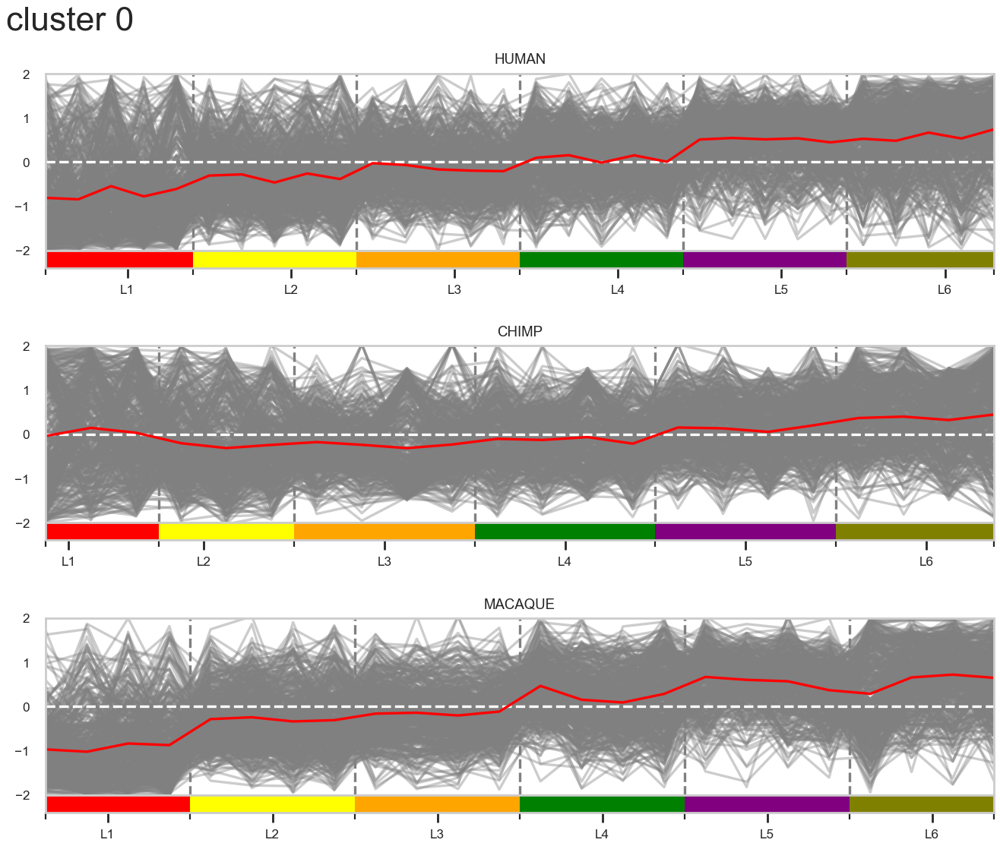

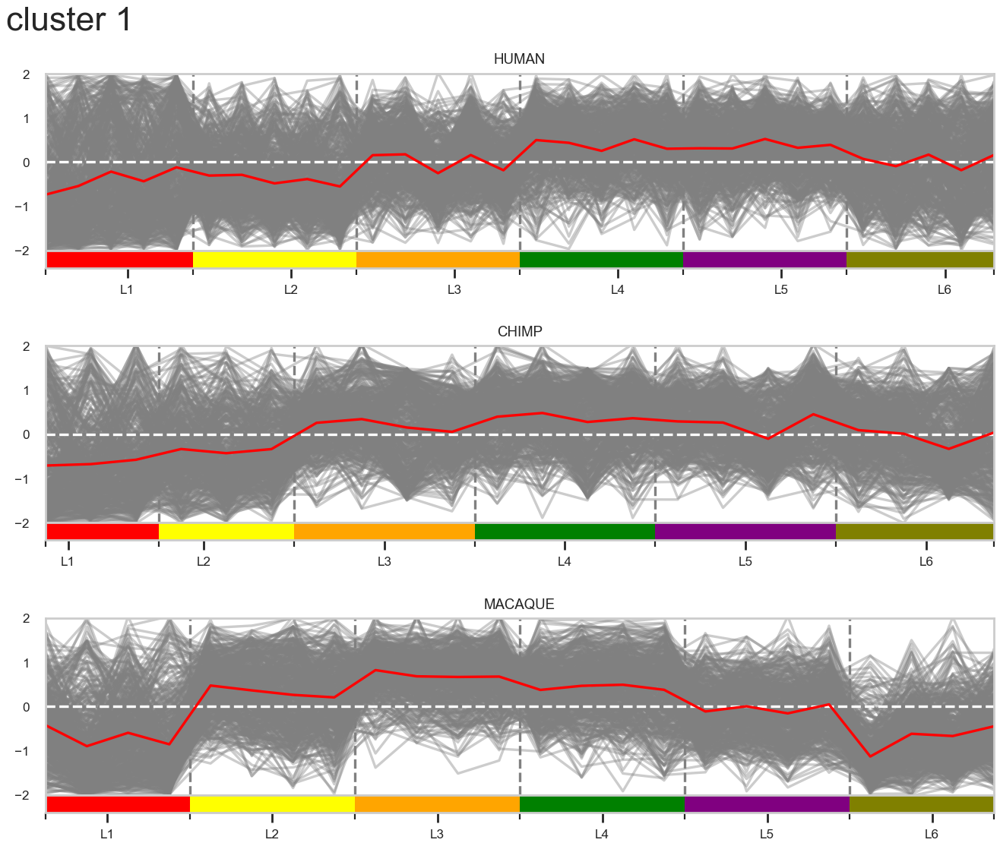

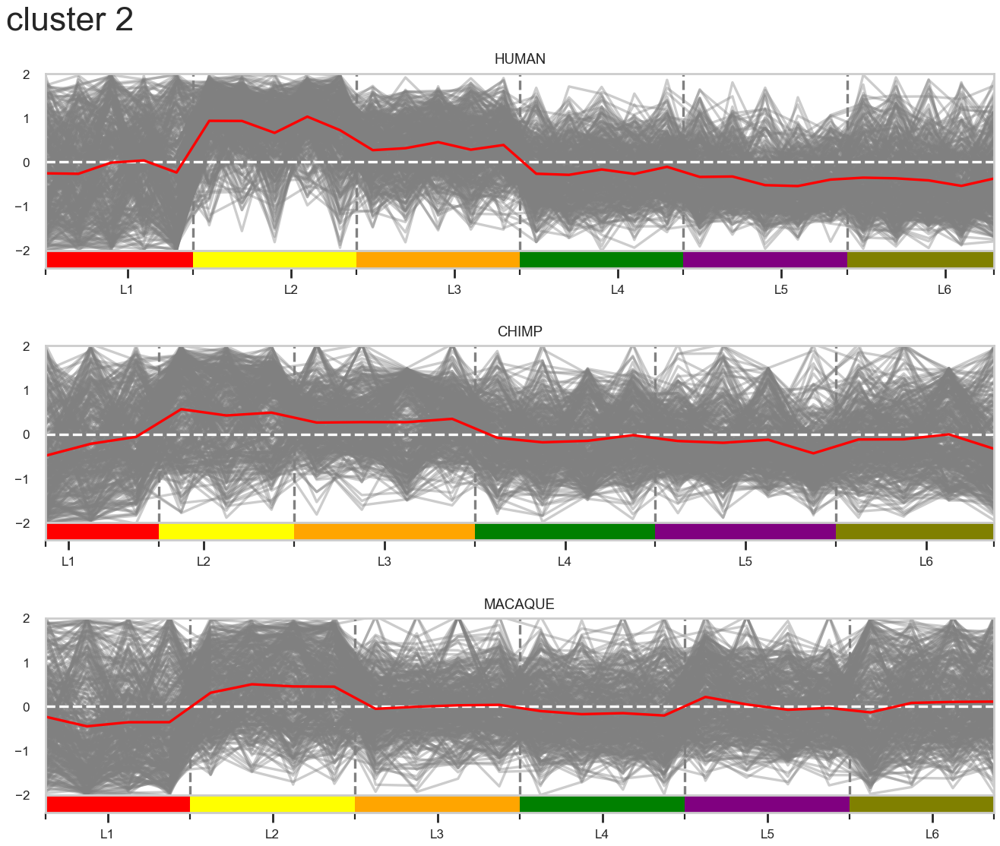

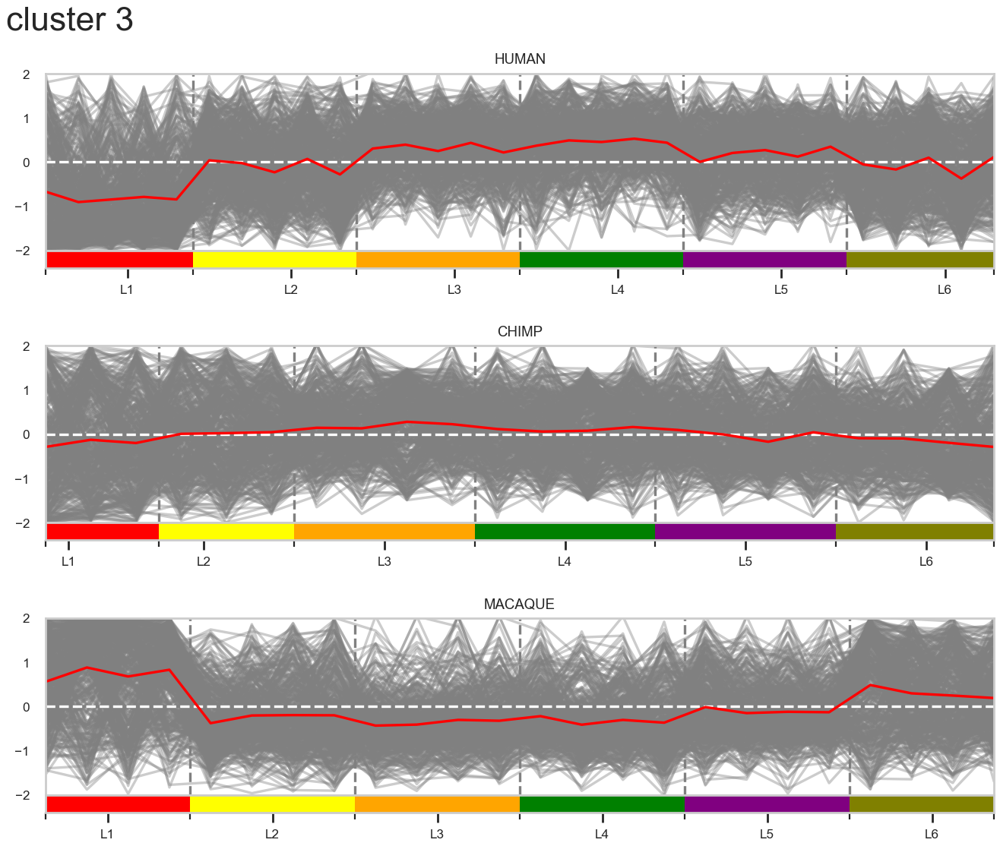

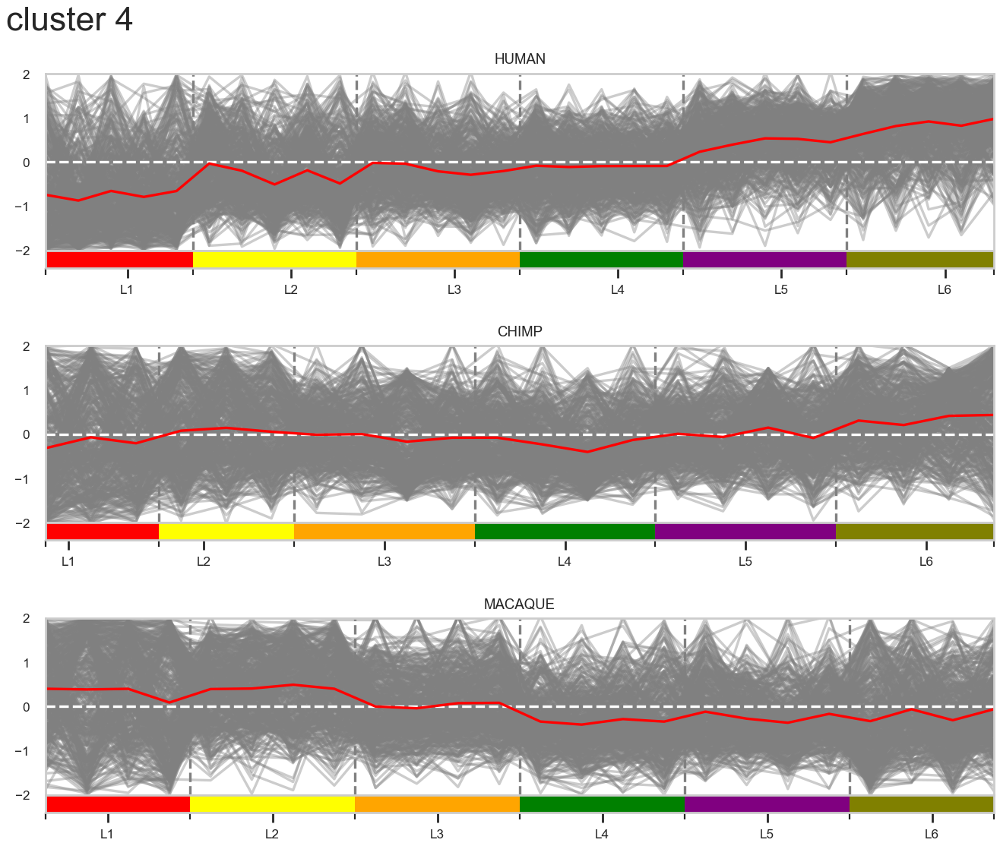

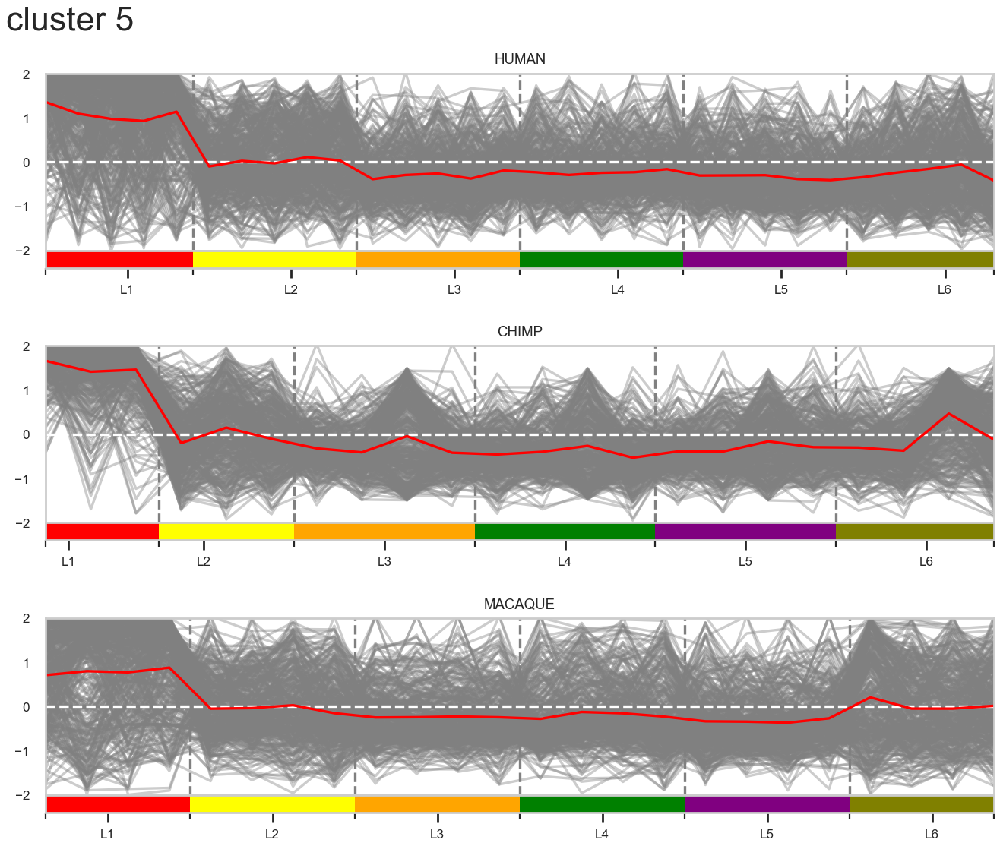

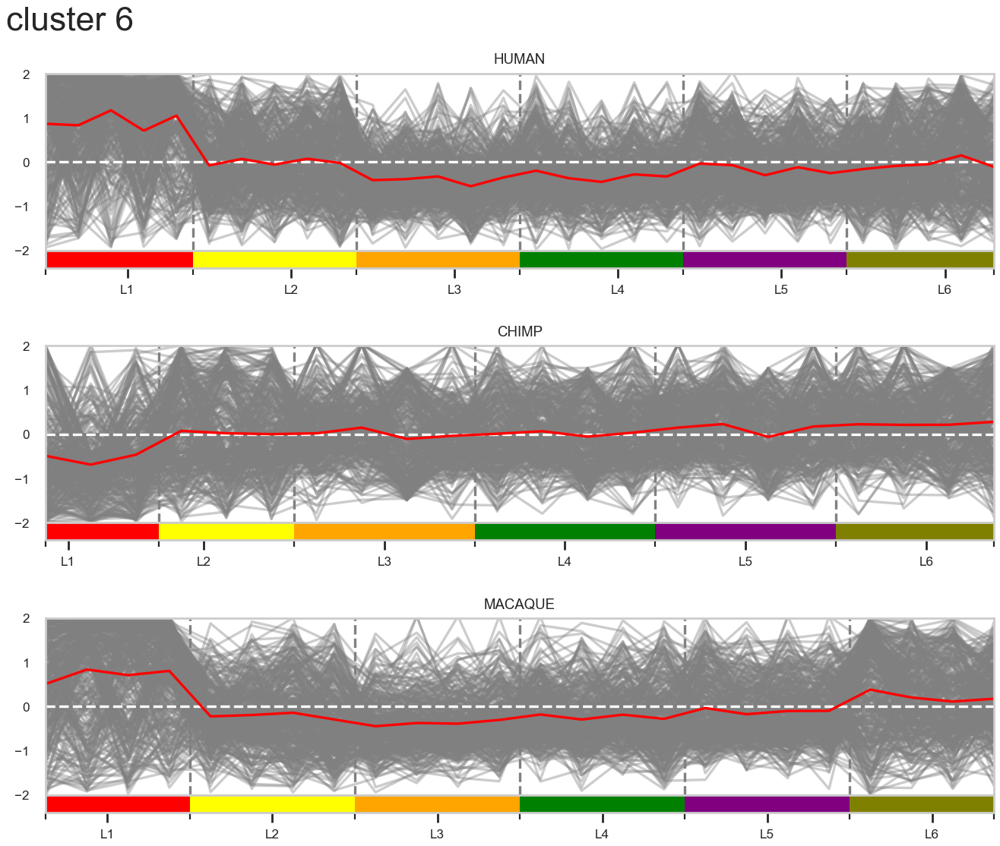

In [152]:
from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib import ticker
sns.set_style("whitegrid")

clusters = np.arange(n_clusters)
colors = cluster_color[:7]

for label in clusters:
    genes = labels[labels == label].index.tolist()

    fig, axes = plt.subplots(3, 1, figsize=(10, 8), gridspec_kw={'hspace': 0.4})
    fig.suptitle(f'cluster {label}', fontsize=20, x=0.2)

    for ax, cond in zip(axes, ['human', 'chimp', 'macaque']):
        # subset df
        df_snake = df.loc[sample_order[cond], genes]
        # count number of samples for each layer
        lines = [sum(map(lambda x: layer in x, sample_order[cond])) for layer in layers]
        # position for layer boarders
        layer_pos = np.cumsum(lines) - 1
        # min and max values
        ymin, ymax = -2, 2
        # sample mean
        sample_mean = df_snake.mean(axis=1)
        # ploting
        ax.plot(np.arange(len(sample_mean)), df_snake, '-', color='grey', alpha=0.4)
        ax.vlines(layer_pos + 0.5, ymin=ymin, ymax=ymax, colors='grey', linestyles='dashed')
        ax.hlines(0, xmin=0, xmax=len(sample_mean) - 1, colors='white', linestyles='dashed')
        ax.plot(np.arange(len(sample_mean)), sample_mean, 'red')
        # customize
        ax.grid(False)
        ax.xaxis.set_major_locator(ticker.NullLocator())
        ax.set_title(cond.upper())
        ax.set_xlim(0, len(sample_mean) - 1)
        ax.set_ylim(ymin, ymax)
        # create colorbar
        divider = make_axes_locatable(ax)
        cax = divider.append_axes('bottom', size='10%', pad=0)
        cmap = mpl.colors.ListedColormap(colors)

        bounds = [0] + list(layer_pos + 0.5)
        bounds[-1] = bounds[-1] - 0.5
        norm = mpl.colors.BoundaryNorm(bounds, cmap.N)
        fig.colorbar(
            mpl.cm.ScalarMappable(cmap=cmap, norm=norm),
            cax=cax,
            ticks=bounds,
            orientation='horizontal',
            spacing='proportional'
        )
        cax.xaxis.set_major_locator(ticker.FixedLocator(layer_pos - 1.5))
        cax.xaxis.set_major_formatter(ticker.FixedFormatter(layers))
    plt.savefig(f'snakeplots/snakeplot_samples_cluster{n_clusters}_{label}.png', bbox_inches='tight')
    #plt.savefig(f'snakeplots/snakeplot_samples_cluster{n_clusters}_{label}.pdf', bbox_inches='tight')

In [153]:
df_annotatin = df.copy()
df_annotatin['layer'] = adata_norm_anova.obs.layer
df_annotatin['condition'] = adata_norm_anova.obs.condition
df_annotatin.head()

,AGRN,UBE2J2,ANKRD65,TMEM240,NADK,GNB1,GABRD,PRXL2B,TP73,CHD5,...,AGPAT3,PFKL,COL18A1,SLC19A1,COL6A2,LSS,DIP2A,PRMT2,layer,condition
L1.human_759,-0.868319,-1.273895,0.408551,-0.471025,-0.682409,-1.934125,0.397623,-1.167772,1.565711,-1.778558,...,0.184877,-1.429609,1.996979,1.003277,1.920101,1.725510,0.999744,1.183187,L1,human
L1.human_j12,-1.069113,-0.588014,-0.938228,-1.721712,-1.123540,-1.828016,0.141235,-1.404020,2.008204,-1.277513,...,-0.558337,0.108595,-0.147327,0.425908,-0.557224,-0.971936,0.516793,-1.086767,L1,human
L1.human_j3,-1.431132,-1.531893,-0.861771,-0.315197,-1.011629,-1.888424,1.906604,-0.886378,2.018815,-1.251054,...,0.458395,-1.730492,-0.751894,1.301890,1.646334,1.263531,0.645498,-1.029481,L1,human
L1.human_j4,-1.376892,-1.905611,0.381697,-1.515402,-0.923861,-1.531136,0.941229,-1.852638,2.020884,-1.661215,...,-0.688949,0.627593,0.266317,-1.044490,-0.095656,1.638709,-0.057202,-0.491130,L1,human
L1.human_j6,0.543266,0.919922,-1.302746,0.234824,0.136143,-0.829423,-0.664192,-1.705269,-0.408248,0.629034,...,-1.538200,-0.744603,1.867280,0.026685,2.016642,0.903245,-0.461949,0.494489,L1,human


In [154]:
layer_mean = df_annotatin.groupby(['condition', 'layer']).mean()
layer_mean.head()

AGRN    UBE2J2  ANKRD65   TMEM240      NADK      GNB1  \
condition layer                                                              
chimp     L1    -0.956192  0.773837      0.0 -1.754486  1.519086 -1.571840   
          L2    -1.097568 -0.993644      0.0 -0.077071 -1.233378  0.725357   
          L3    -0.228824 -0.175268      0.0 -0.006117  0.364381  0.733233   
          L4     0.716686  0.784959      0.0  0.508951  0.024738  0.677719   
          L5     0.673588 -0.446070      0.0  0.409698 -0.021703 -0.178134   

                    GABRD    PRXL2B      TP73      CHD5  ...     PDE9A  \
condition layer                                          ...             
chimp     L1    -0.549265 -0.357797  1.841219 -1.434529  ...  0.231898   
          L2    -0.855741  0.555384 -0.725681  0.374346  ...  0.852112   
          L3     0.887532  0.506415 -0.428375  0.481862  ... -0.612015   
          L4     0.382980  0.369754 -0.119940  0.284855  ... -0.468330   
          L5    -0.176356 -0.236206 -0.179036  0.095954  ...  0.158071   

                   NDUFV3    AGPAT3      PFKL   COL18A1   SLC19A1  COL6A2  \
condition layer                                                             
chimp     L1    -0.397632  1.532410  0.383942  2.013880 -0.756343     0.0   
          L2     0.388778 -0.320263  0.117511 -0.194445 -0.371989     0.0   
          L3    -0.637413 -0.114175 -0.112595 -0.209578  0.457760     0.0   
          L4    -0.407863 -0.933538 -0.211769 -0.650473 -0.339898     0.0   
          L5     0.136434 -0.188412 -0.209679 -0.040143 -0.386431     0.0   

                      LSS     DIP2A     PRMT2  
condition layer                                
chimp     L1    -0.136083 -0.648532 -0.666795  
          L2    -0.136083 -0.073788  0.984509  
          L3     0.885310 -0.930961 -0.949598  
          L4    -0.227062 -0.640886 -0.302950  
          L5    -0.227062  0.659761  0.064038  

[5 rows x 2740 columns]

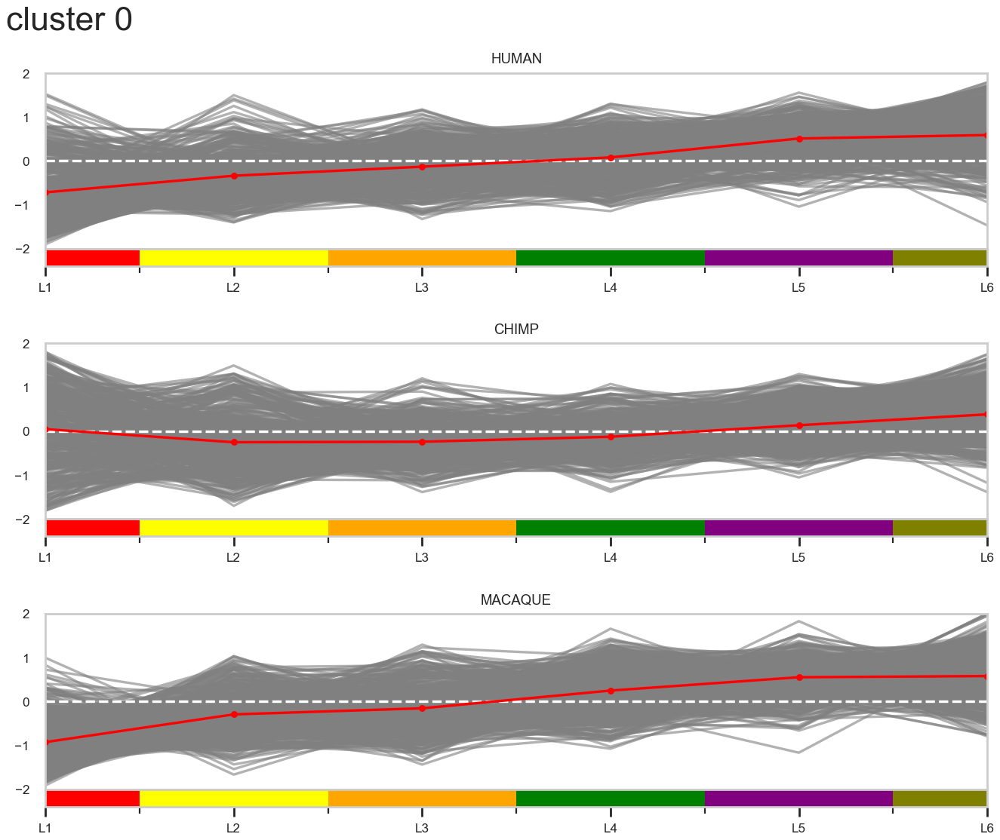

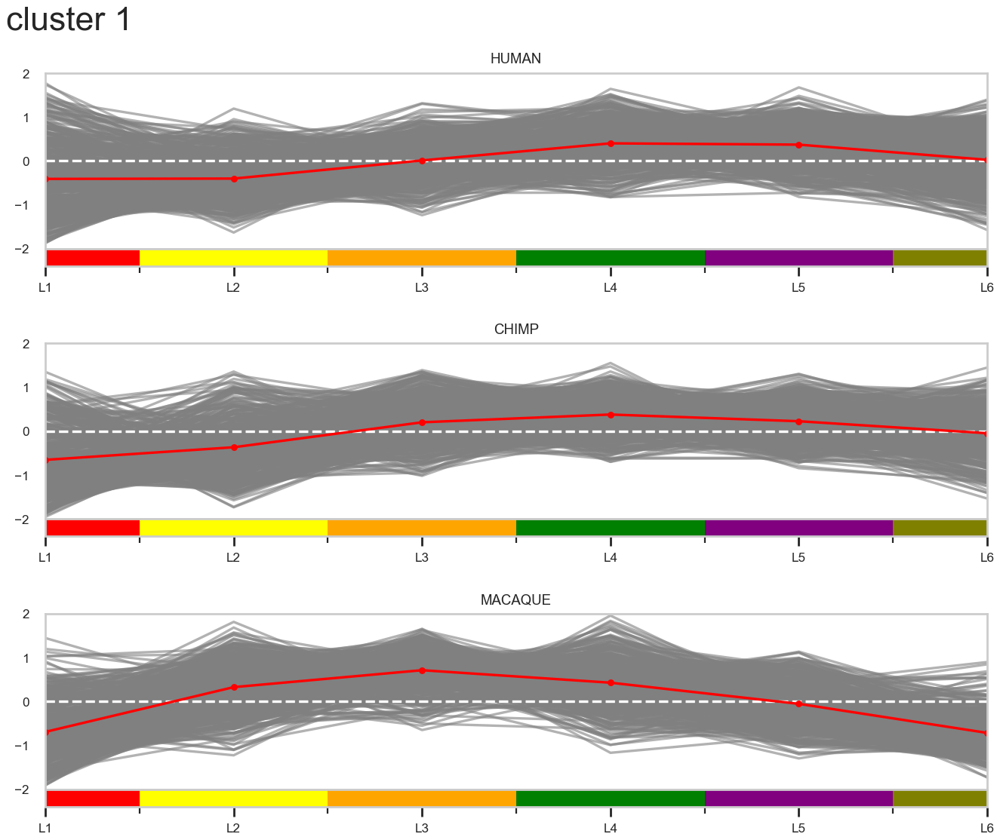

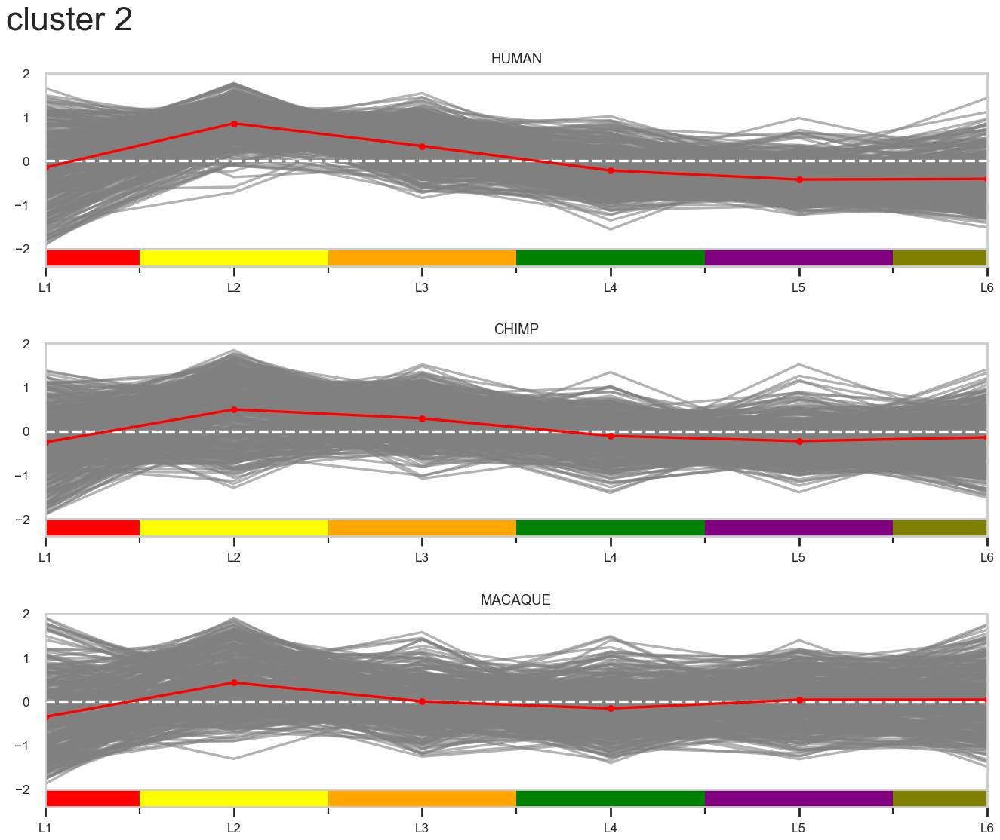

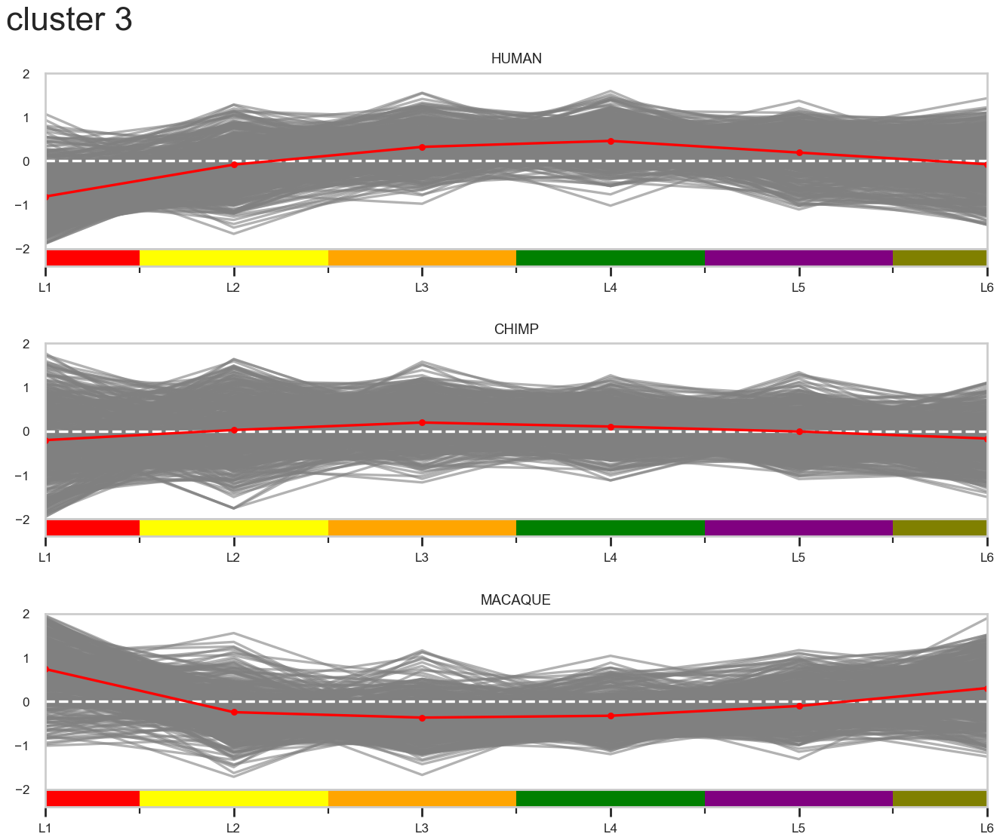

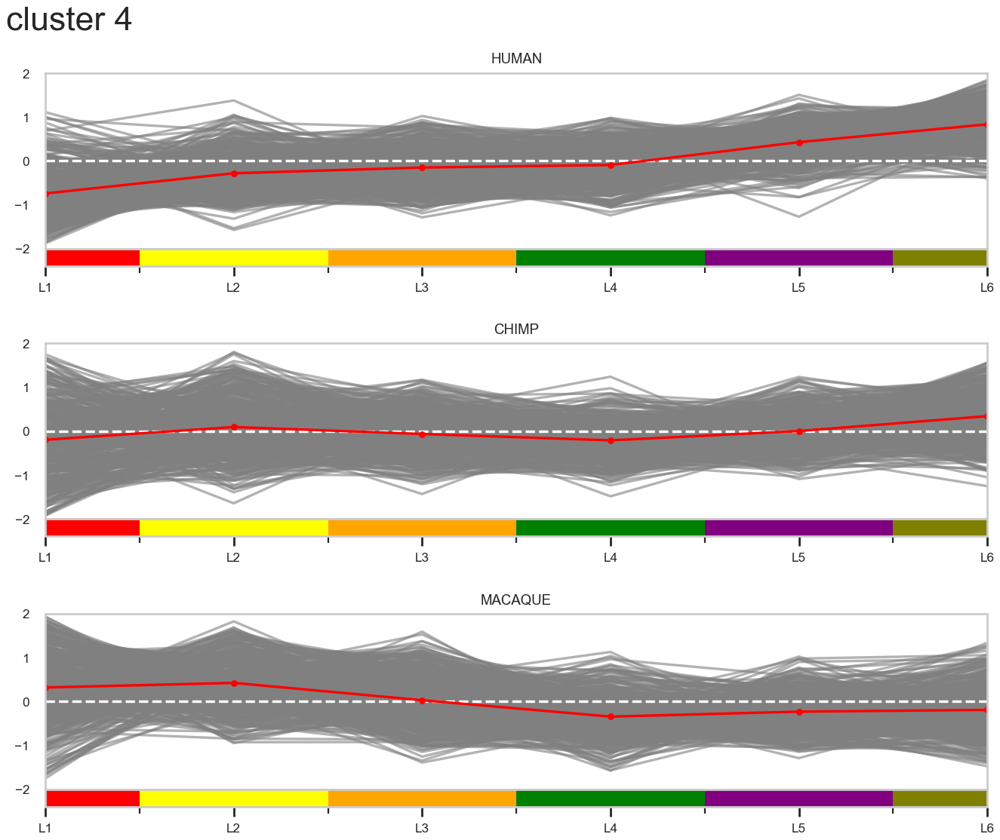

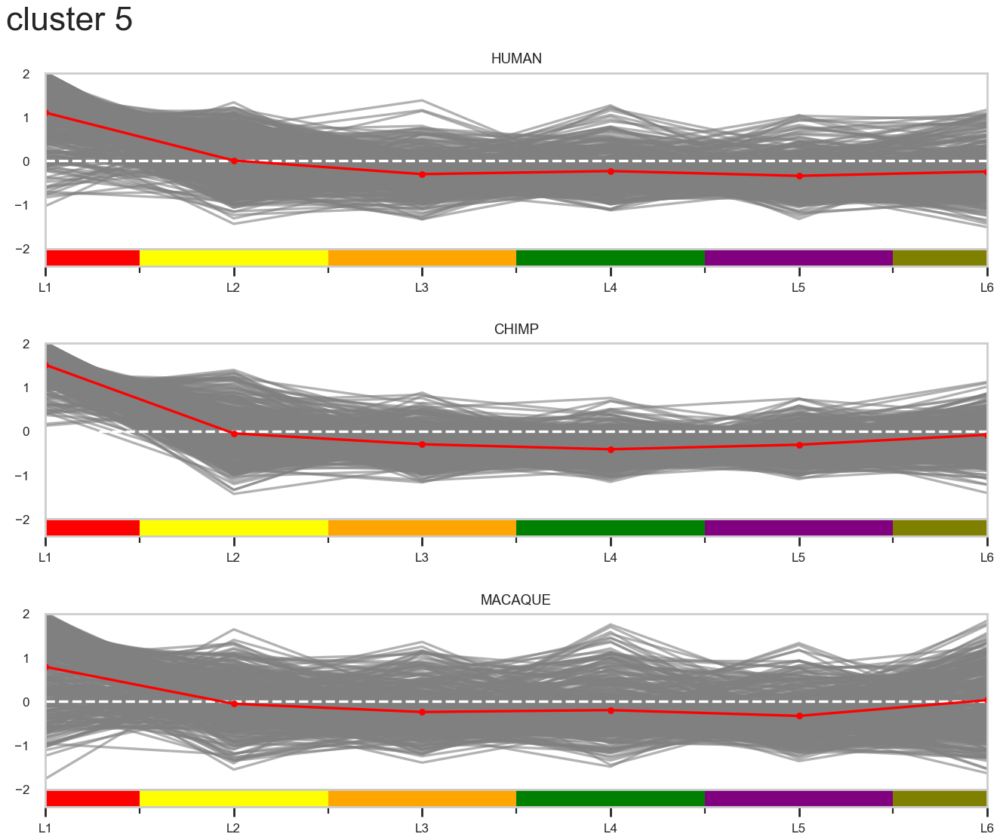

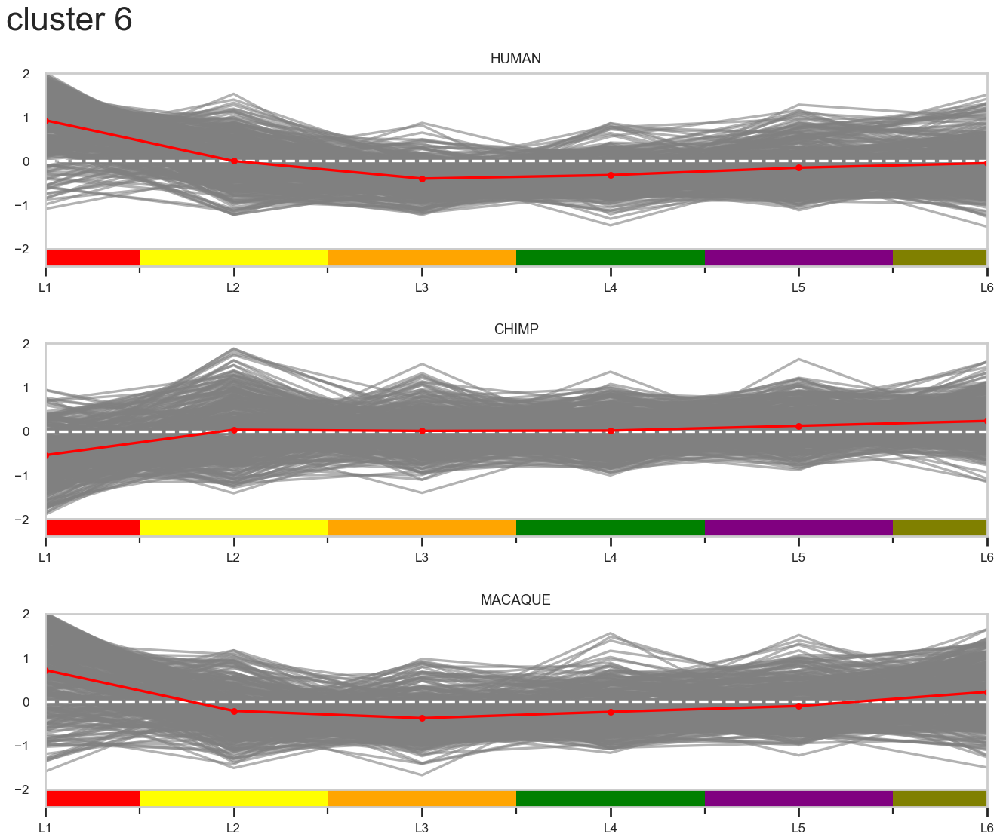

In [155]:
from mpl_toolkits.axes_grid1 import make_axes_locatable

clusters = np.arange(n_clusters)
colors = cluster_color[:7]

for label in clusters:
    genes = labels[labels == label].index.tolist()

    fig, axes = plt.subplots(3, 1, figsize=(10, 8), gridspec_kw={'hspace': 0.4})
    fig.suptitle(f'cluster {label}', fontsize=20, x=0.2)

    for ax, cond in zip(axes, ['human', 'chimp', 'macaque']):
        # subset df
        df_snake = layer_mean.loc[cond, genes].loc[layers]
        # position for layers
        layer_pos = np.arange(6)
        # min and max values
        ymin, ymax = -2, 2
        # sample mean
        sample_mean = df_snake.mean(axis=1)
        # ploting
        ax.plot(layer_pos, df_snake, '-', color='grey', alpha=0.6)
        ax.hlines(0, xmin=0, xmax=5, colors='white', linestyles='dashed')
        ax.plot(layer_pos, sample_mean, '.-', color='red')
        # customize
        ax.grid(False)
        ax.xaxis.set_major_locator(ticker.NullLocator())
        ax.set_title(cond.upper())
        ax.set_xlim(0, 5)
        ax.set_ylim(ymin, ymax)
        # create colorbar
        divider = make_axes_locatable(ax)
        cax = divider.append_axes('bottom', size='10%', pad=0)
        cmap = mpl.colors.ListedColormap(colors)

        bounds = [0] + list(layer_pos + 0.5)
        bounds[-1] = bounds[-1] - 0.5
        norm = mpl.colors.BoundaryNorm(bounds, cmap.N)
        fig.colorbar(
            mpl.cm.ScalarMappable(cmap=cmap, norm=norm),
            cax=cax,
            ticks=bounds,
            orientation='horizontal',
            spacing='proportional'
        )
        cax.xaxis.set_major_locator(ticker.FixedLocator(layer_pos))
        cax.xaxis.set_major_formatter(ticker.FixedFormatter(layers))
    plt.savefig(f'snakeplots/snakeplot_layers_cluster{n_clusters}_{label}.png', bbox_inches='tight')
    #plt.savefig(f'snakeplots/snakeplot_layers_cluster{label}.pdf', bbox_inches='tight')

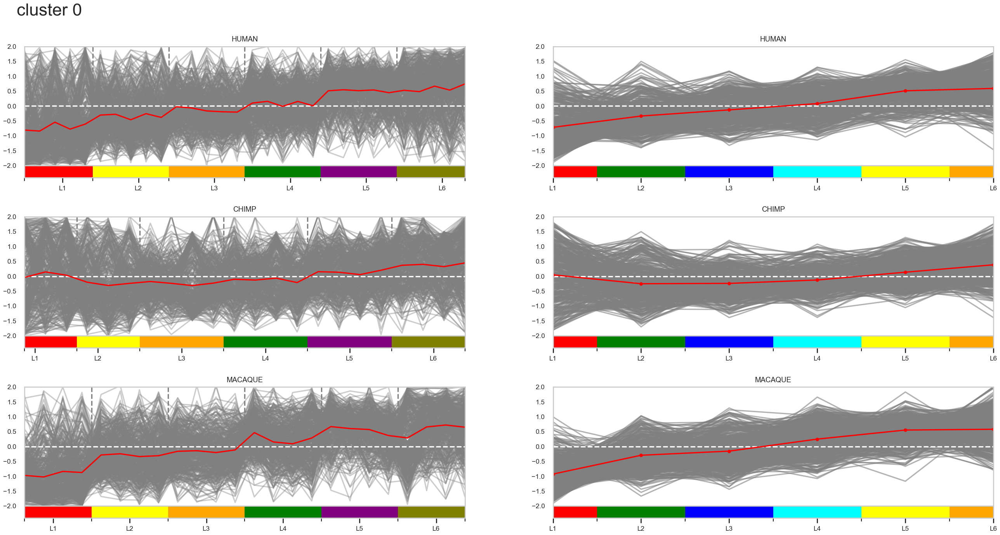

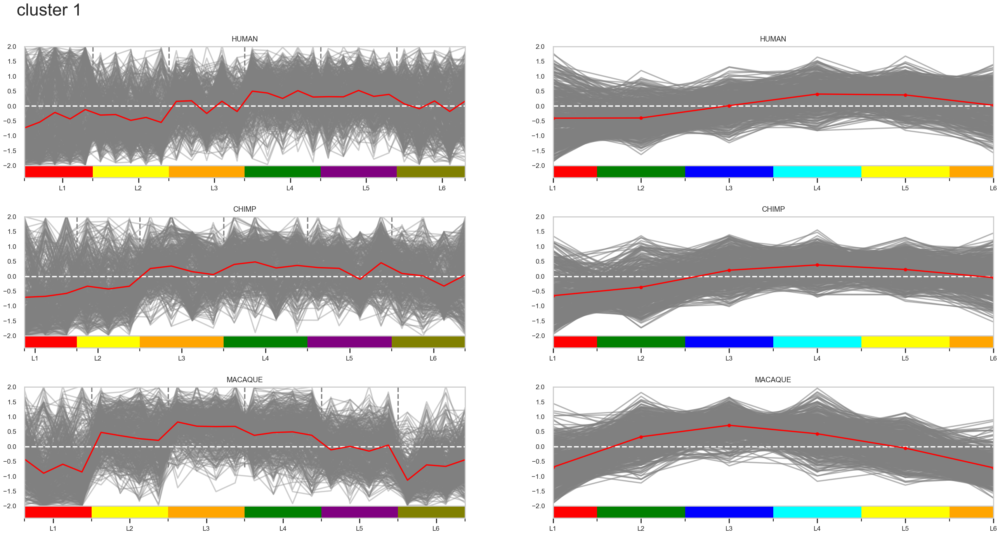

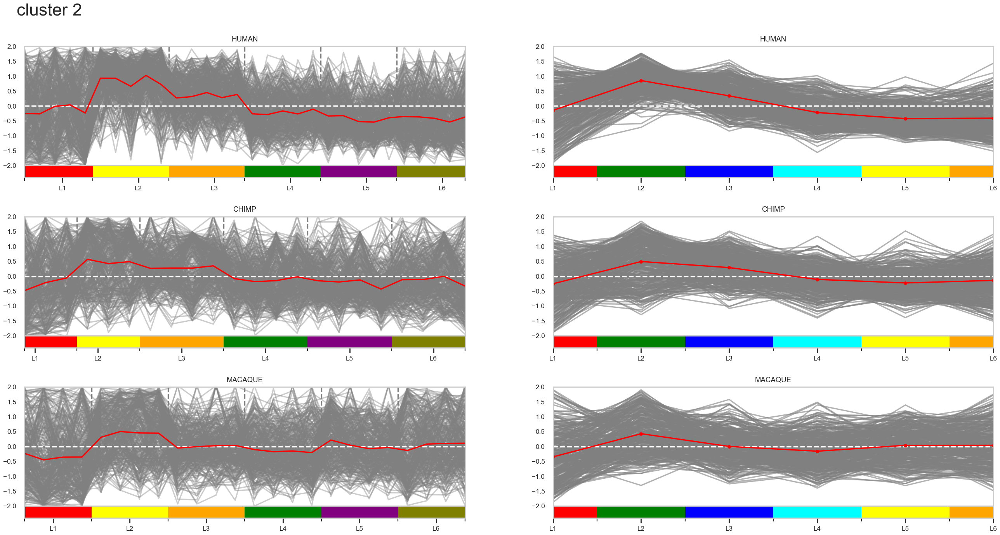

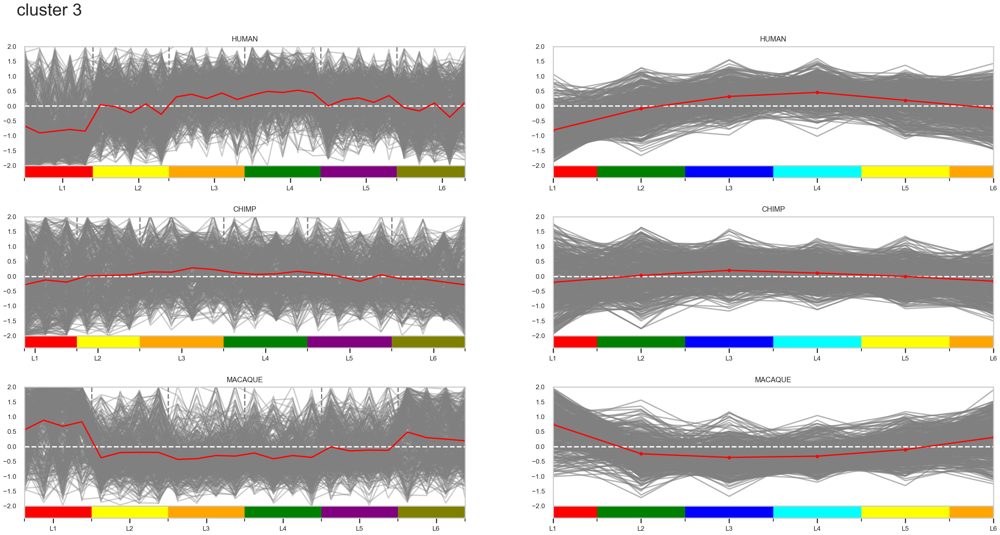

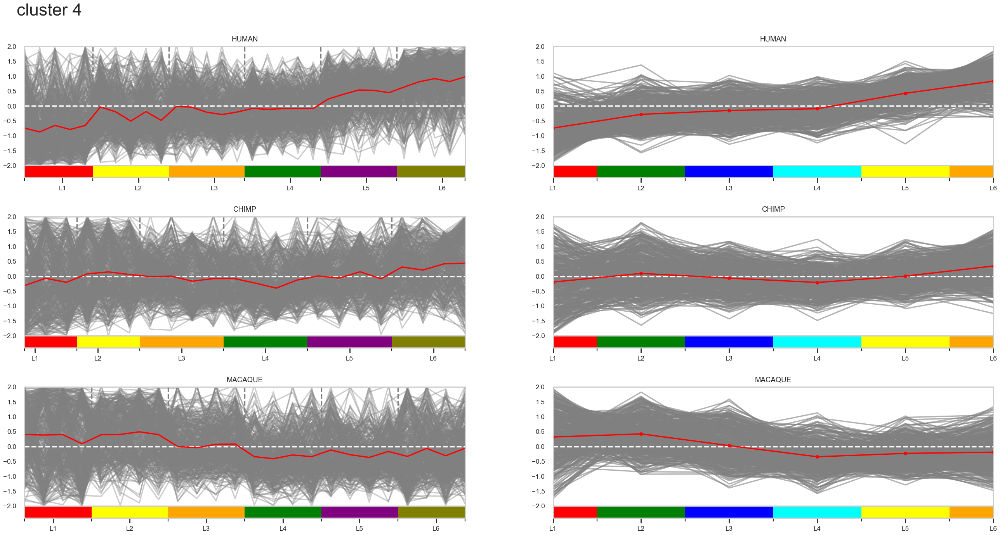

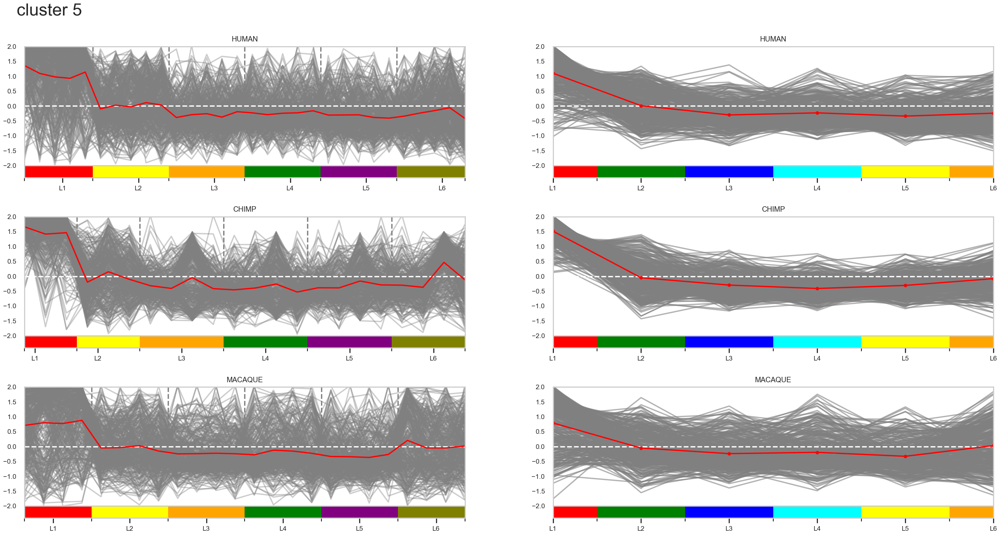

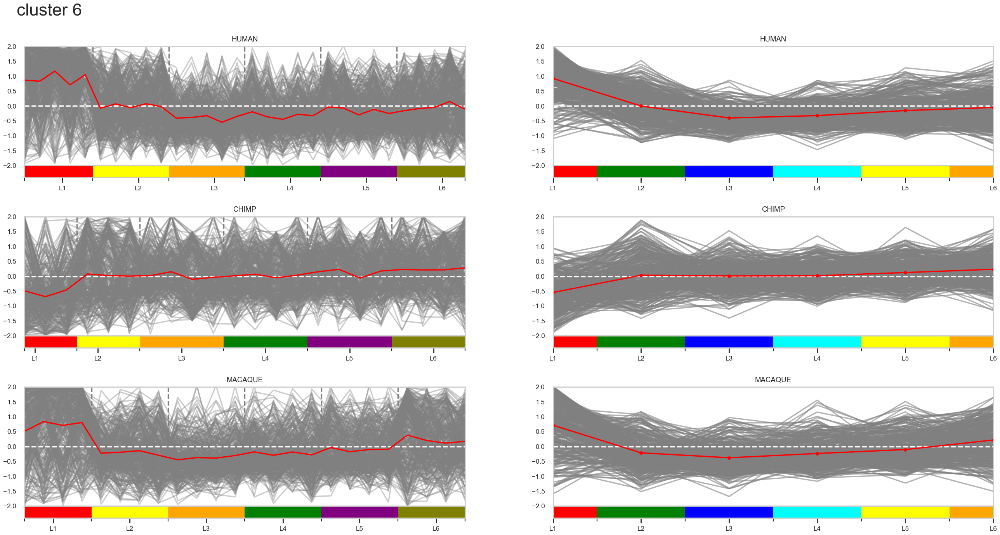

In [156]:
from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib import ticker

clusters = np.arange(n_clusters)
colors = cluster_color[:7]

for label in clusters:
    genes = labels[labels == label].index.tolist()

    fig, axes = plt.subplots(3, 2, figsize=(20, 10), gridspec_kw={'hspace': 0.3})
    fig.suptitle(f'cluster {label}', fontsize=20, x=0.2)

    for ax, cond in zip(axes[:, 0], ['human', 'chimp', 'macaque']):
        # subset df
        df_snake = df.loc[sample_order[cond], genes]
        # count number of samples for each layer
        lines = [sum(map(lambda x: layer in x, sample_order[cond])) for layer in layers]
        # position for layer boarders
        layer_pos = np.cumsum(lines) - 1
        # min and max values
        ymin, ymax = -2, 2
        # sample mean
        sample_mean = df_snake.mean(axis=1)
        # ploting
        ax.plot(np.arange(len(sample_mean)), df_snake, '-', color='grey', alpha=0.4)
        ax.vlines(layer_pos + 0.5, ymin=-0.7, ymax=ymax, colors='grey', linestyles='dashed')
        ax.hlines(0, xmin=0, xmax=len(sample_mean) - 1, colors='white', linestyles='dashed')
        ax.plot(np.arange(len(sample_mean)), sample_mean, 'red')
        # customize
        ax.grid(False)
        ax.xaxis.set_major_locator(ticker.NullLocator())
        ax.set_title(cond.upper())
        ax.set_xlim(0, len(sample_mean) - 1)
        ax.set_ylim(ymin, ymax)
        # create colorbar
        divider = make_axes_locatable(ax)
        cax = divider.append_axes('bottom', size='10%', pad=0)
        cmap = mpl.colors.ListedColormap(colors)

        bounds = [0] + list(layer_pos + 0.5)
        bounds[-1] = bounds[-1] - 0.5
        norm = mpl.colors.BoundaryNorm(bounds, cmap.N)
        fig.colorbar(
            mpl.cm.ScalarMappable(cmap=cmap, norm=norm),
            cax=cax,
            ticks=bounds,
            orientation='horizontal',
            spacing='proportional'
        )
        cax.xaxis.set_major_locator(ticker.FixedLocator(layer_pos - 1.5))
        cax.xaxis.set_major_formatter(ticker.FixedFormatter(layers))

    for ax, cond in zip(axes[:, 1], ['human', 'chimp', 'macaque']):
        # subset df
        df_snake = layer_mean.loc[cond, genes].loc[layers]
        # position for layers
        layer_pos = np.arange(6)
        # min and max values
        ymin, ymax = -2, 2
        # sample mean
        sample_mean = df_snake.mean(axis=1)
        # ploting
        ax.plot(layer_pos, df_snake, '-', color='grey', alpha=0.6)
        ax.hlines(0, xmin=0, xmax=5, colors='white', linestyles='dashed')
        ax.plot(layer_pos, sample_mean, '.-', color='red')
        # customize
        ax.grid(False)
        ax.xaxis.set_major_locator(ticker.NullLocator())
        ax.set_title(cond.upper())
        ax.set_xlim(0, 5)
        ax.set_ylim(ymin, ymax)
        # create colorbar
        divider = make_axes_locatable(ax)
        cax = divider.append_axes('bottom', size='10%', pad=0)
        cmap = mpl.colors.ListedColormap(['red', 'green', 'blue', 'cyan', 'yellow', 'brown', 'orange'])

        bounds = [0] + list(layer_pos + 0.5)
        bounds[-1] = bounds[-1] - 0.5
        norm = mpl.colors.BoundaryNorm(bounds, cmap.N)
        fig.colorbar(
            mpl.cm.ScalarMappable(cmap=cmap, norm=norm),
            cax=cax,
            ticks=bounds,
            orientation='horizontal',
            spacing='proportional'
        )
        cax.xaxis.set_major_locator(ticker.FixedLocator(layer_pos))
        cax.xaxis.set_major_formatter(ticker.FixedFormatter(layers))
    plt.savefig(f'snakeplots/snakeplot_samples_layers_cluster{n_clusters}_{label}.png', bbox_inches='tight')
    #plt.savefig(f'snakeplots/snakeplot_samples_layers_cluster{label}.pdf', bbox_inches='tight')

### Jaccard

In [160]:
n_clusters = 7
labels = pd.read_csv(de_dir_path + f'cluster_spectr_anova_{n_clusters}.csv', index_col=0)['0'].sort_values()
labels_wm = pd.read_csv('../../../results/DE/mammals/ANOVA_zscore/' + f'cluster_spectr_anova_{n_clusters}.csv', index_col=0)['0'].sort_values()

In [170]:
dummie_clust = (
    labels
    .astype(str)
    .str
    .get_dummies()
)
dummie_clust.columns = dummie_clust.columns + '_laminar'
dummie_clust.head()

,0_laminar,1_laminar,2_laminar,3_laminar,4_laminar,5_laminar,6_laminar
TRIB1,1,0,0,0,0,0,0
KLF6,1,0,0,0,0,0,0
SNX19,1,0,0,0,0,0,0
SPA17,1,0,0,0,0,0,0
TMEM25,1,0,0,0,0,0,0


In [171]:
dummie_clust_wm = (
    labels_wm
    .astype(str)
    .str
    .get_dummies()
)
dummie_clust_wm.columns = dummie_clust.columns + '_wm'
dummie_clust_wm.head()

,0_laminar_wm,1_laminar_wm,2_laminar_wm,3_laminar_wm,4_laminar_wm,5_laminar_wm,6_laminar_wm
PRMT2,1,0,0,0,0,0,0
CELF4,1,0,0,0,0,0,0
MRPL40,1,0,0,0,0,0,0
CDH2,1,0,0,0,0,0,0
BRINP2,1,0,0,0,0,0,0


In [173]:
dummie_clust_concat = pd.concat([dummie_clust, dummie_clust_wm], axis=1).fillna(0)
dummie_clust_concat.head()

,0_laminar,1_laminar,2_laminar,3_laminar,4_laminar,5_laminar,6_laminar,0_laminar_wm,1_laminar_wm,2_laminar_wm,3_laminar_wm,4_laminar_wm,5_laminar_wm,6_laminar_wm
TRIB1,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
KLF6,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
SNX19,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
SPA17,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
TMEM25,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0


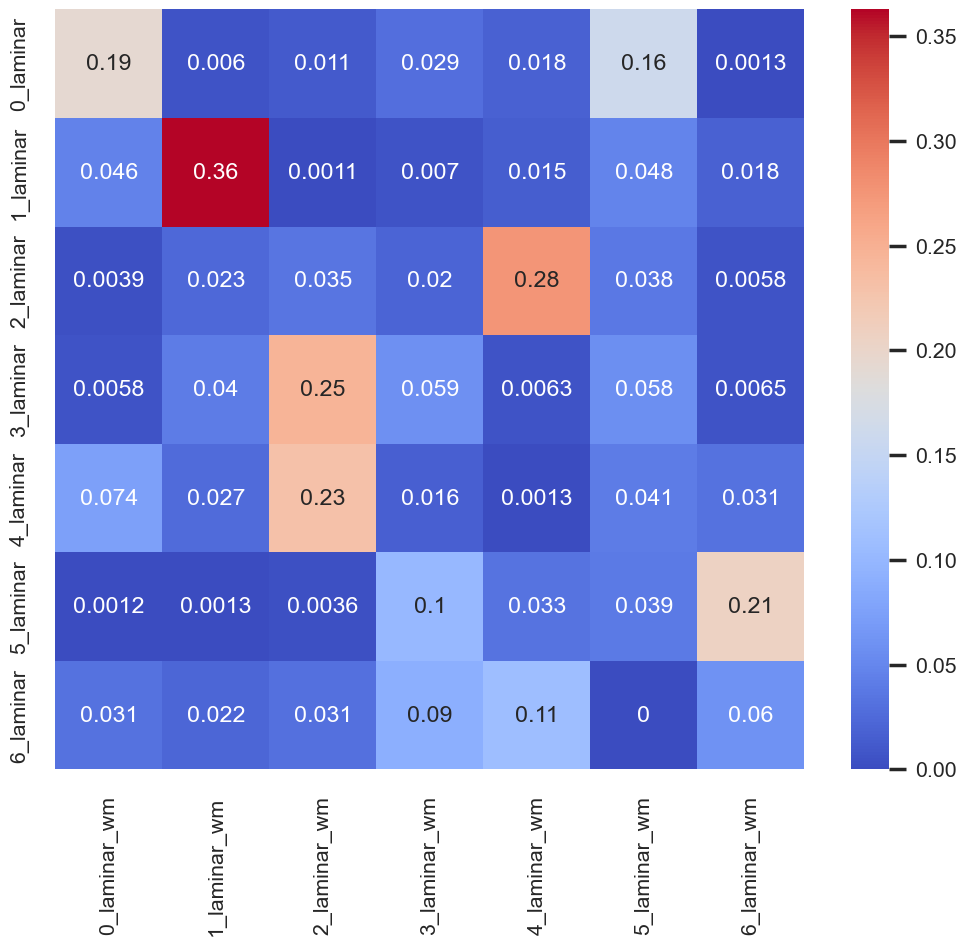

In [180]:
from sklearn.metrics import DistanceMetric
dist = DistanceMetric.get_metric('jaccard')
pairwise_jaccard = pd.DataFrame(1 - dist.pairwise(dummie_clust_concat.T), columns=dummie_clust_concat.columns, index=dummie_clust_concat.columns)
pairwise_jaccard

plt.figure(figsize=(6, 5), dpi=100)
sns.heatmap(pairwise_jaccard.loc[dummie_clust.columns, dummie_clust_wm.columns], annot=True, cmap = 'coolwarm')
plt.grid(False)